In [1]:
#importing reqired libraries
from keras.preprocessing.image import ImageDataGenerator
import numpy as np
import keras
import matplotlib.pyplot as plt

In [2]:
#loading training dataset
train_datagen = ImageDataGenerator(rescale= 1./255,
                                  shear_range=0.2,
                                  zoom_range=0.2,
                                  horizontal_flip=True)
train_generator = train_datagen.flow_from_directory('C:\\Users\\sowndariya\\Desktop\\PGAA Capstone Projects-20210205T113733Z-001\\PGAA Capstone Projects\\CV\\Dataset\\House_dataset\\House_dataset\\Training1',target_size=(64,64), batch_size=32, class_mode='categorical')

Found 1818 images belonging to 2 classes.


In [3]:
train_generator.class_indices

{'House': 0, 'Not_House': 1}

In [4]:
#loading testing data
validation = train_datagen.flow_from_directory('C:\\Users\\sowndariya\\Desktop\\PGAA Capstone Projects-20210205T113733Z-001\\PGAA Capstone Projects\\CV\\Dataset\\House_dataset\\House_dataset\\Validation1', 
                                              target_size=(64,64), batch_size=32, class_mode='categorical')

Found 321 images belonging to 2 classes.


In [5]:
validation.class_indices

{'House': 0, 'Not_House': 1}

In [6]:
#importing required libs
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten, MaxPool2D

In [7]:
#initilizing the sequential kernel model and adding layers
model = Sequential()
model.add(Conv2D(filters=48, kernel_size=3, activation='relu', input_shape=[64,64,3]))
model.add(MaxPool2D(pool_size = 2, strides=2))
model.add(keras.layers.Conv2D(filters=40, kernel_size=3, activation='relu'))
model.add(keras.layers.MaxPool2D(pool_size=2, strides=2))
model.add(Conv2D(filters=32, kernel_size=3, activation='relu'))
model.add(MaxPool2D(pool_size = 2, strides=2))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(2, activation='sigmoid'))

In [8]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 62, 62, 48)        1344      
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 31, 31, 48)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 29, 29, 40)        17320     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 14, 14, 40)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 12, 12, 32)        11552     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 6, 6, 32)          0         
_________________________________________________________________
flatten (Flatten)            (None, 1152)              0

In [9]:

#compile and train the cnn
model.compile(optimizer='rmsprop', loss='binary_crossentropy',  metrics=["accuracy"])

In [ ]:
#fitting train data to model
hist = model.fit(x=train_generator, validation_data=validation, epochs=20)

Epoch 1/20
57/57 [==============================] - 97s 2s/step - loss: 0.2194 - accuracy: 0.9131 - val_loss: 0.4117 - val_accuracy: 0.8380
Epoch 2/20
57/57 [==============================] - 87s 2s/step - loss: 0.2012 - accuracy: 0.9246 - val_loss: 0.3670 - val_accuracy: 0.8598
Epoch 3/20
57/57 [==============================] - 106s 2s/step - loss: 0.1968 - accuracy: 0.9235 - val_loss: 0.4390 - val_accuracy: 0.8287
Epoch 4/20
57/57 [==============================] - 105s 2s/step - loss: 0.1921 - accuracy: 0.9202 - val_loss: 0.3535 - val_accuracy: 0.8567
Epoch 5/20
57/57 [==============================] - 88s 2s/step - loss: 0.1946 - accuracy: 0.9235 - val_loss: 0.4138 - val_accuracy: 0.8287
Epoch 6/20
57/57 [==============================] - 86s 2s/step - loss: 0.1714 - accuracy: 0.9318 - val_loss: 0.4018 - val_accuracy: 0.8474
Epoch 7/20
57/57 [==============================] - 87s 2s/step - loss: 0.1712 - accuracy: 0.9323 - val_loss: 0.2784 - val_accuracy: 0.8941
Epoch 8/20
57/57 [

In [ ]:
hist.history.keys()

## PLOTTING THE LOSS AND ACCURACY


In [ ]:
acc = hist.history['accuracy']
val_acc = hist.history['val_accuracy']
loss = hist.history['loss']
val_loss = hist.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'ro', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'ro', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()


## Predicting Test Images

In [60]:
import os
path = 'C:\\Users\\sowndariya\\Desktop\\PGAA Capstone Projects-20210205T113733Z-001\\PGAA Capstone Projects\\CV\\Dataset\\House_dataset\\House_dataset\\Testing chi'
files = []
# r=root, d=directories, f = files
for r, d, f in os.walk(path):
    for file in f:
        if '.jpg' in file:
            files.append(os.path.join(r, file))

In [61]:
from keras.preprocessing import image
# Defining function to testing the model
def testing_image(image_directory):
    test_image = image.load_img(image_directory, target_size = (64, 64))
    test_image = image.img_to_array(test_image)
    test_image = np.expand_dims(test_image, axis = 0)
    result = model.predict(test_image)
    result = np.argmax(result)
    if result == 0:
        prediction = 'HOUSE'
    else:
        prediction = 'NOT HOUSE'
    return prediction

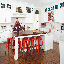

In [63]:
new = image.load_img('Image (1).jpeg', target_size = (64,64))
new

In [64]:
testing_image('Image (1).jpeg')

'HOUSE'

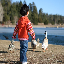

In [65]:
new = image.load_img('Image (4).jpg', target_size = (64,64))
new

In [66]:
testing_image('Image (4).jpg')

'NOT HOUSE'

In [67]:
result_test = []
for i in files:
    result_test.append(testing_image(i))

HOUSE


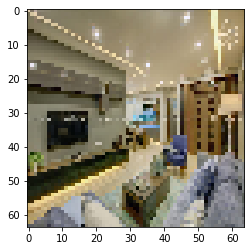

HOUSE


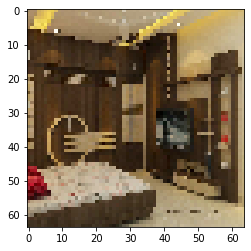

NOT HOUSE


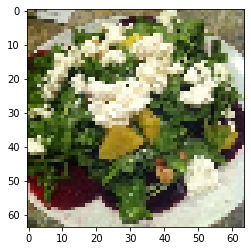

NOT HOUSE


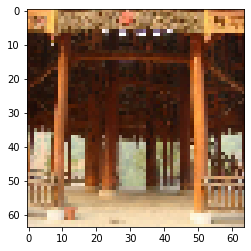

HOUSE


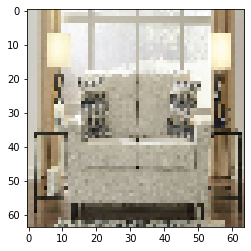

HOUSE


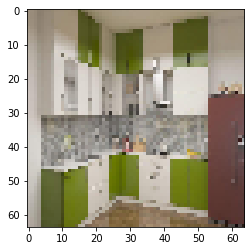

NOT HOUSE


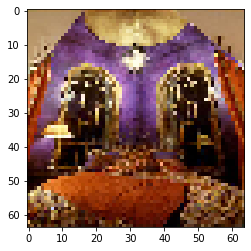

HOUSE


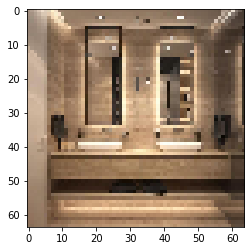

NOT HOUSE


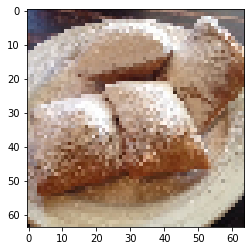

NOT HOUSE


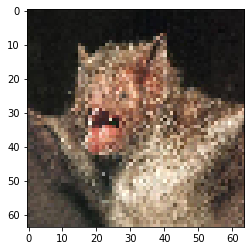

HOUSE


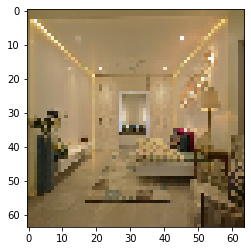

NOT HOUSE


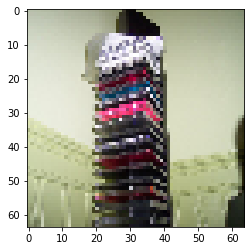

HOUSE


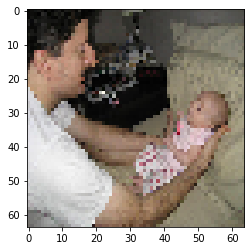

HOUSE


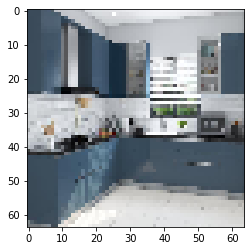

NOT HOUSE


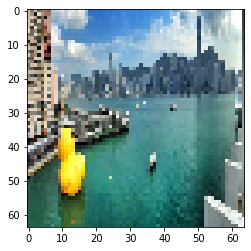

NOT HOUSE


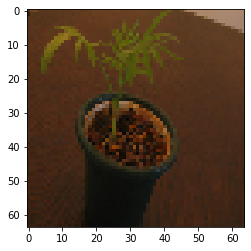

HOUSE


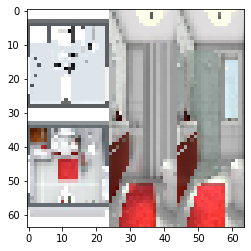

NOT HOUSE


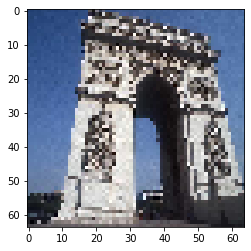

HOUSE


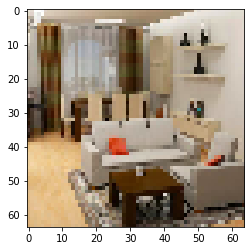

NOT HOUSE


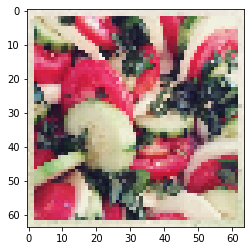

NOT HOUSE


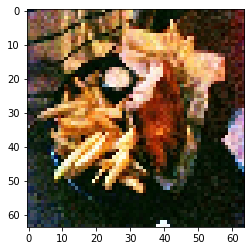

HOUSE


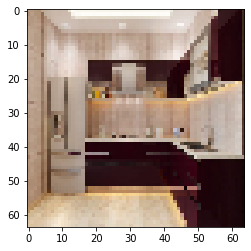

HOUSE


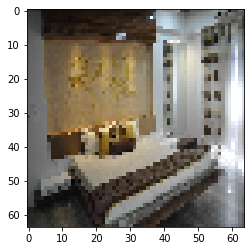

NOT HOUSE


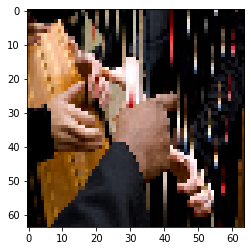

NOT HOUSE


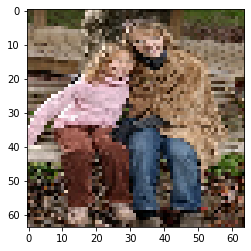

HOUSE


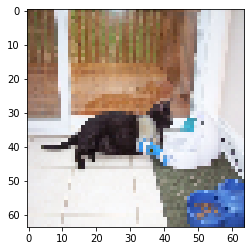

HOUSE


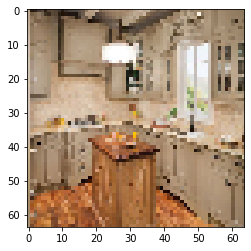

HOUSE


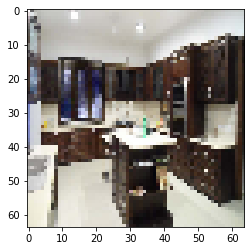

HOUSE


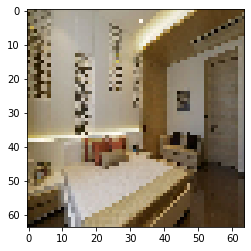

NOT HOUSE


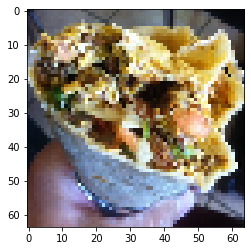

NOT HOUSE


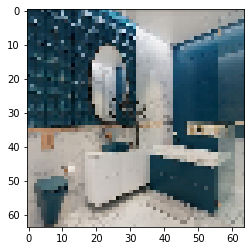

NOT HOUSE


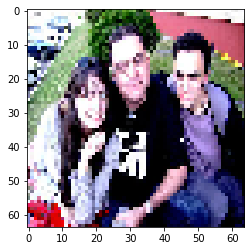

NOT HOUSE


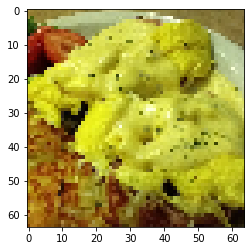

NOT HOUSE


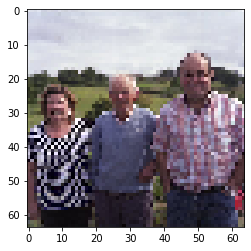

NOT HOUSE


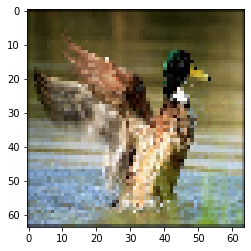

NOT HOUSE


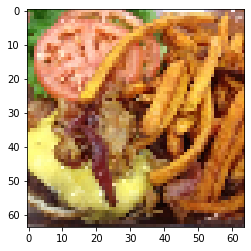

NOT HOUSE


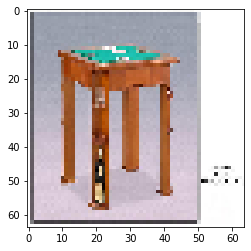

HOUSE


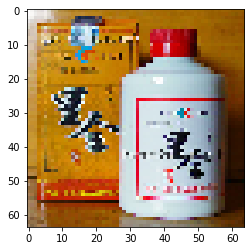

HOUSE


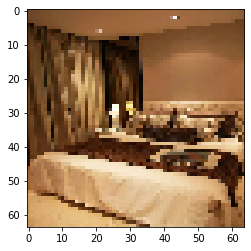

HOUSE


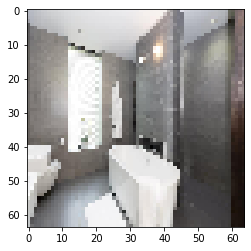

HOUSE


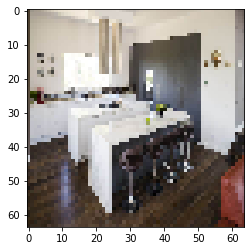

HOUSE


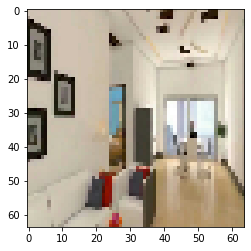

HOUSE


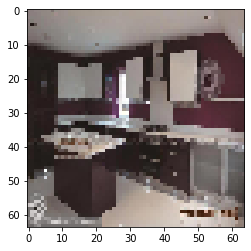

HOUSE


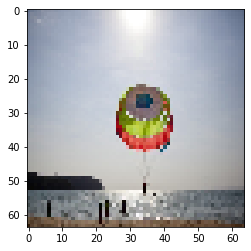

NOT HOUSE


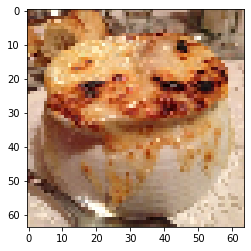

HOUSE


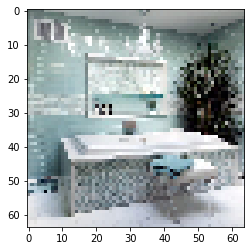

NOT HOUSE


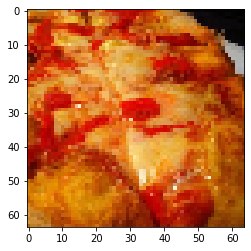

NOT HOUSE


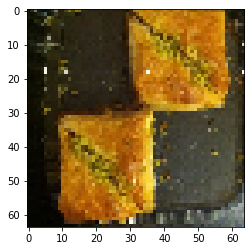

NOT HOUSE


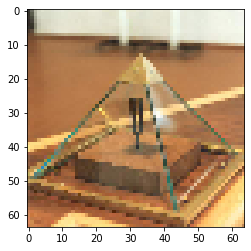

HOUSE


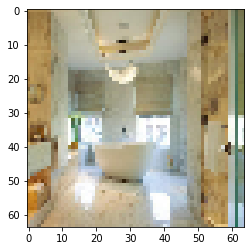

HOUSE


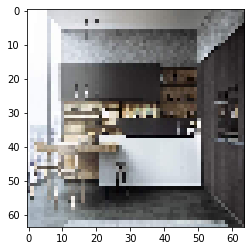

NOT HOUSE


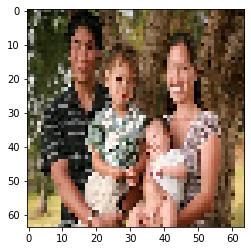

NOT HOUSE


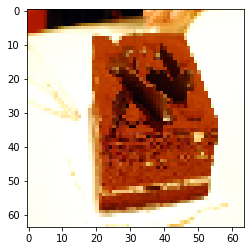

HOUSE


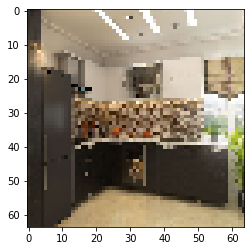

HOUSE


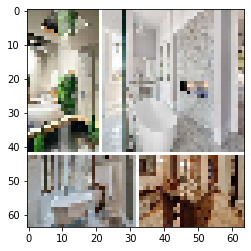

HOUSE


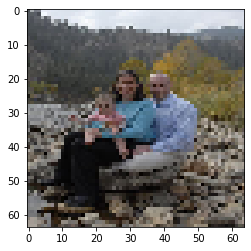

NOT HOUSE


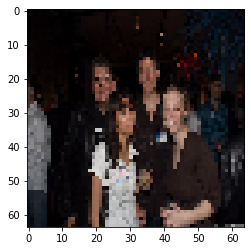

NOT HOUSE


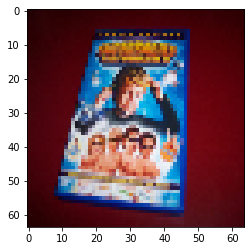

NOT HOUSE


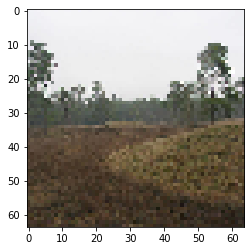

NOT HOUSE


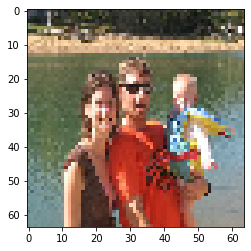

HOUSE


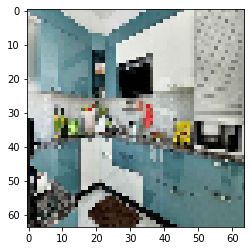

HOUSE


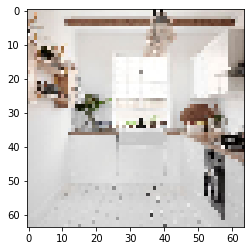

NOT HOUSE


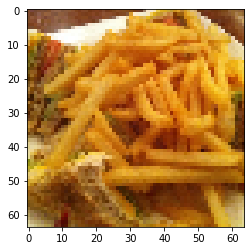

HOUSE


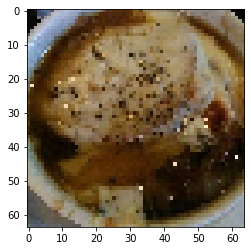

HOUSE


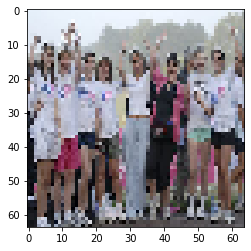

HOUSE


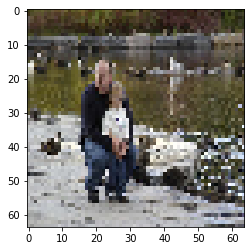

NOT HOUSE


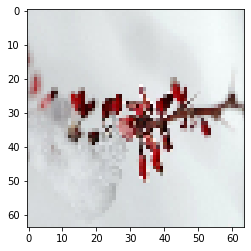

NOT HOUSE


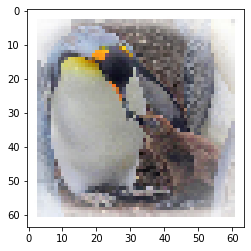

NOT HOUSE


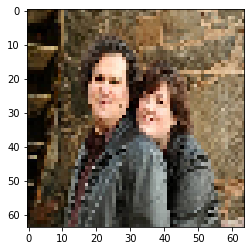

HOUSE


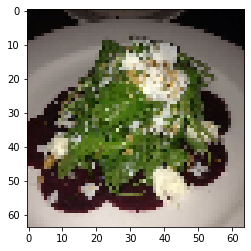

HOUSE


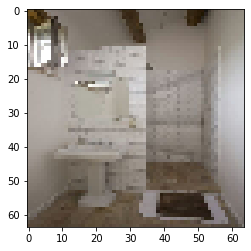

HOUSE


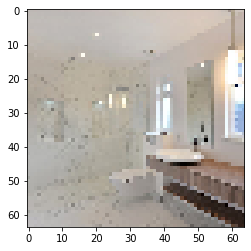

NOT HOUSE


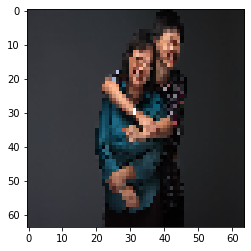

HOUSE


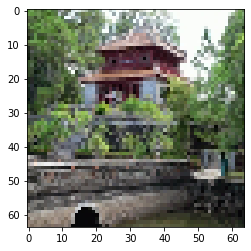

NOT HOUSE


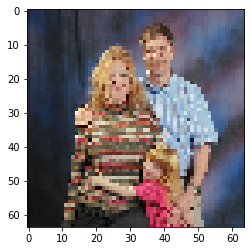

NOT HOUSE


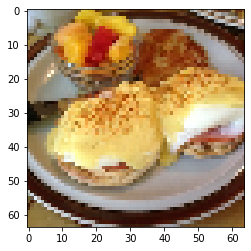

HOUSE


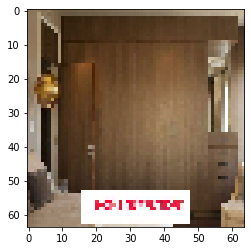

HOUSE


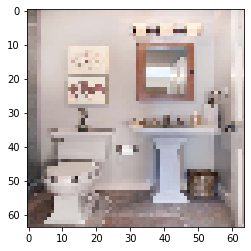

HOUSE


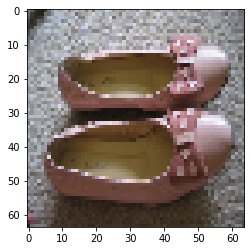

HOUSE


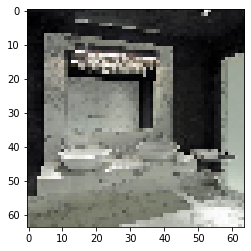

HOUSE


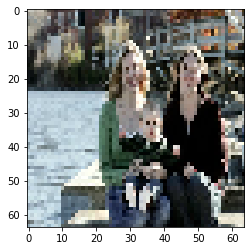

NOT HOUSE


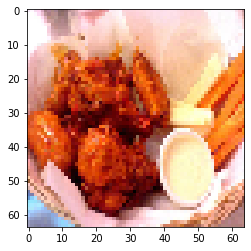

HOUSE


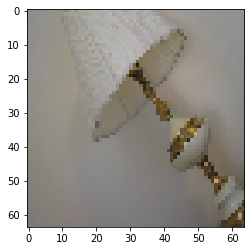

HOUSE


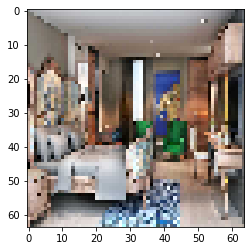

NOT HOUSE


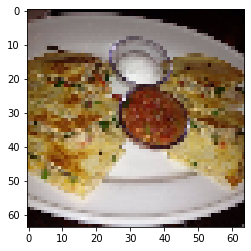

NOT HOUSE


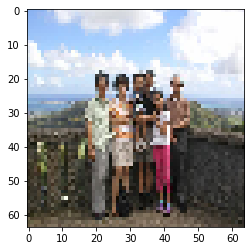

HOUSE


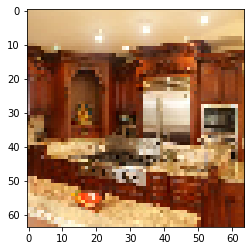

HOUSE


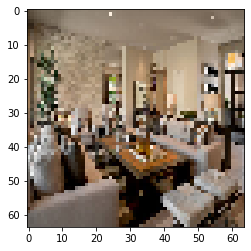

HOUSE


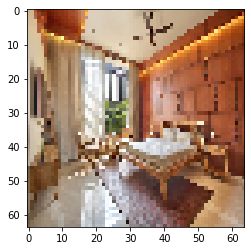

NOT HOUSE


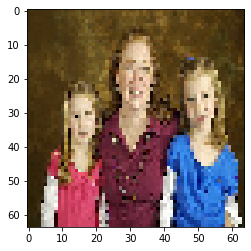

NOT HOUSE


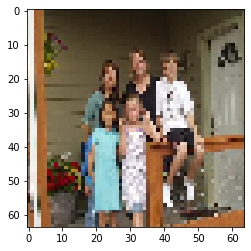

NOT HOUSE


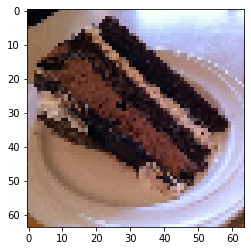

HOUSE


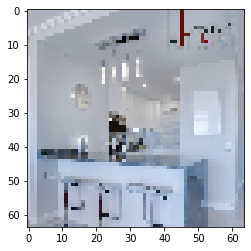

HOUSE


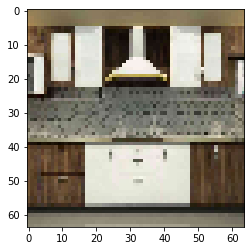

NOT HOUSE


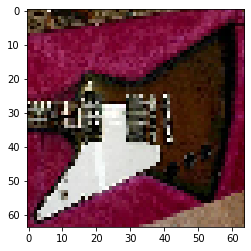

HOUSE


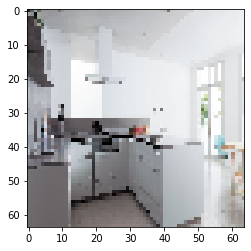

NOT HOUSE


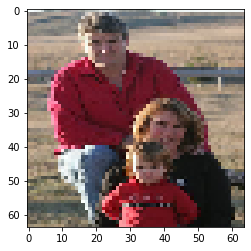

NOT HOUSE


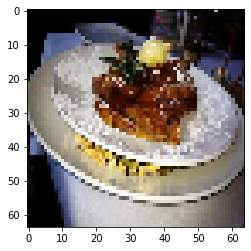

NOT HOUSE


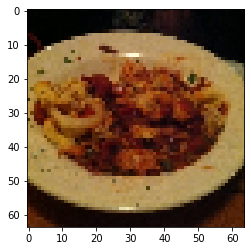

NOT HOUSE


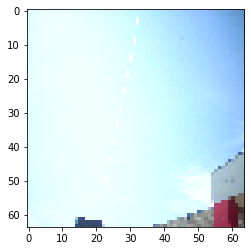

HOUSE


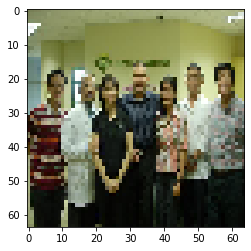

NOT HOUSE


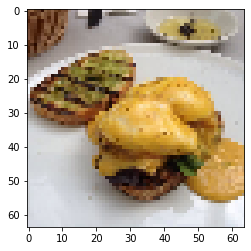

HOUSE


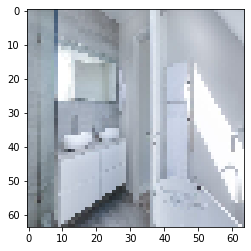

HOUSE


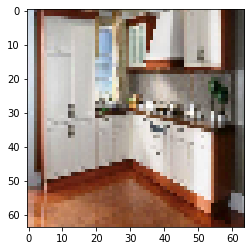

HOUSE


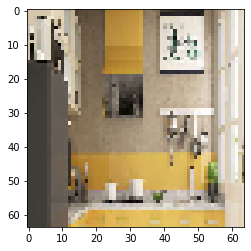

HOUSE


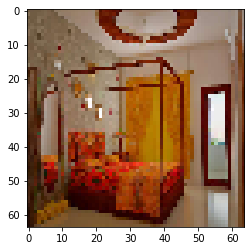

HOUSE


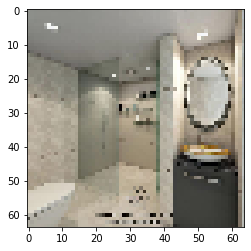

HOUSE


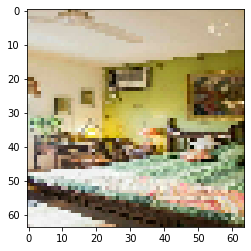

HOUSE


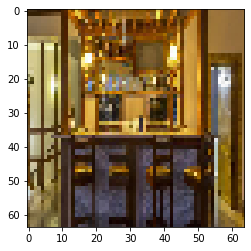

NOT HOUSE


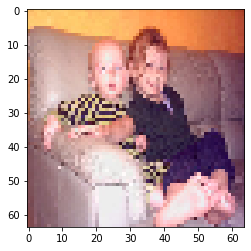

HOUSE


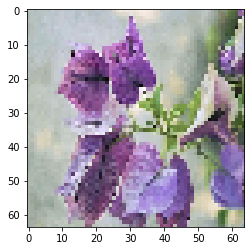

NOT HOUSE


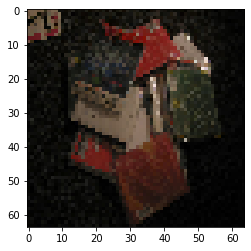

NOT HOUSE


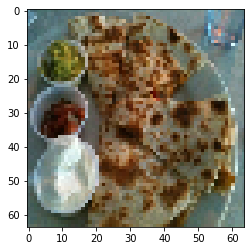

HOUSE


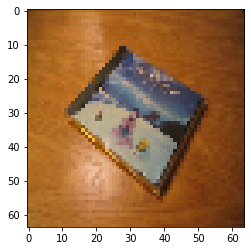

NOT HOUSE


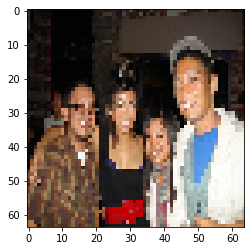

HOUSE


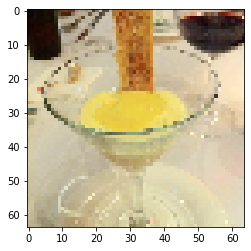

HOUSE


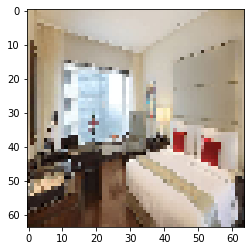

NOT HOUSE


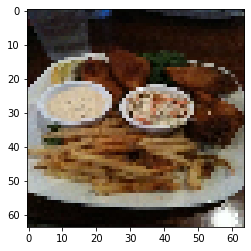

HOUSE


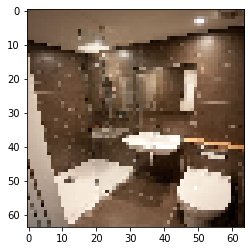

NOT HOUSE


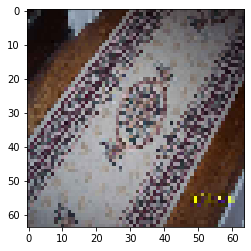

HOUSE


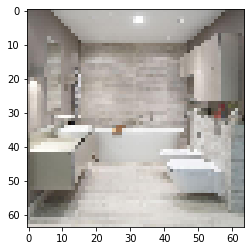

NOT HOUSE


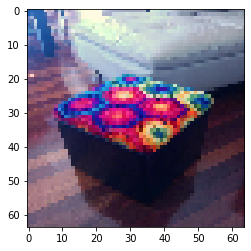

HOUSE


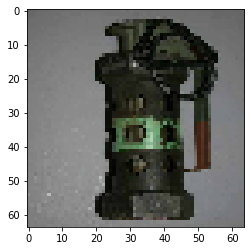

NOT HOUSE


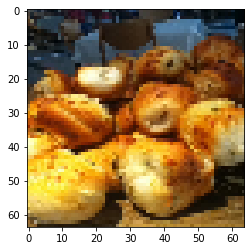

HOUSE


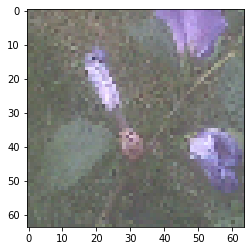

NOT HOUSE


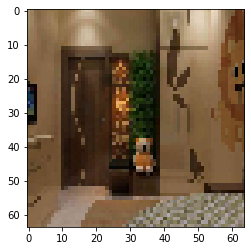

NOT HOUSE


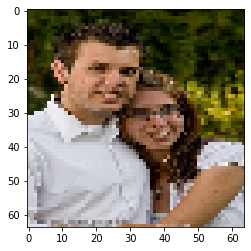

NOT HOUSE


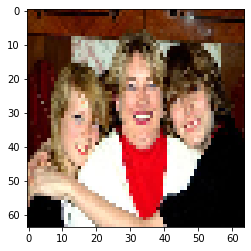

NOT HOUSE


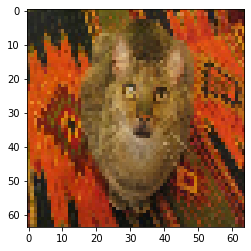

NOT HOUSE


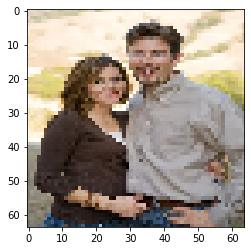

HOUSE


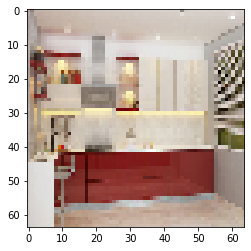

NOT HOUSE


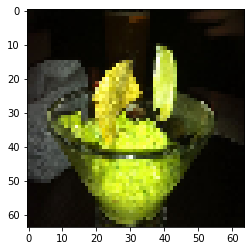

HOUSE


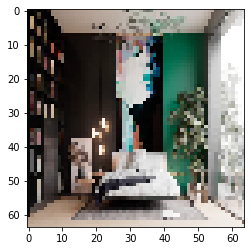

HOUSE


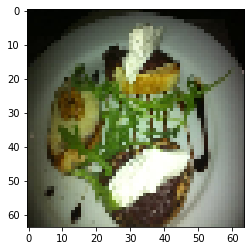

HOUSE


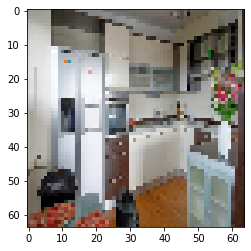

HOUSE


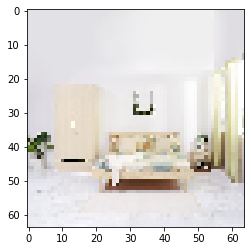

NOT HOUSE


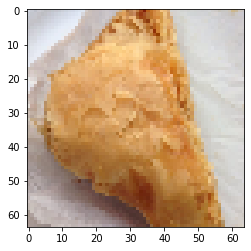

NOT HOUSE


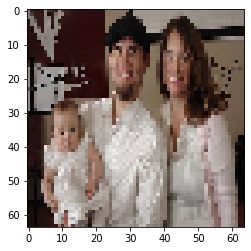

NOT HOUSE


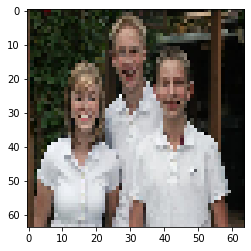

HOUSE


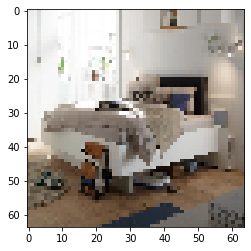

HOUSE


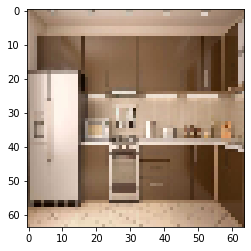

HOUSE


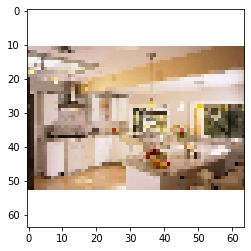

HOUSE


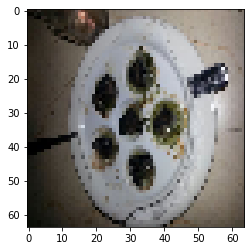

NOT HOUSE


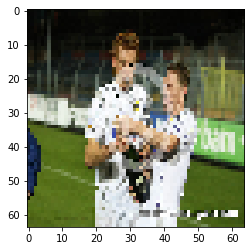

NOT HOUSE


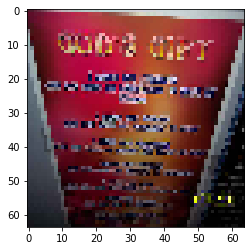

HOUSE


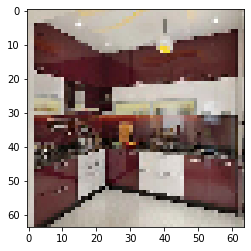

HOUSE


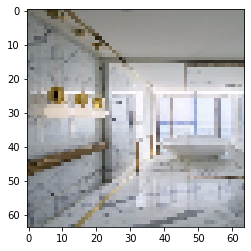

NOT HOUSE


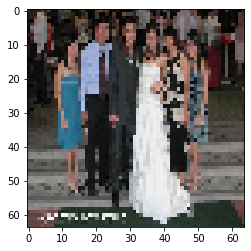

NOT HOUSE


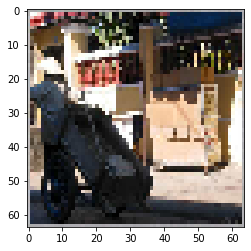

NOT HOUSE


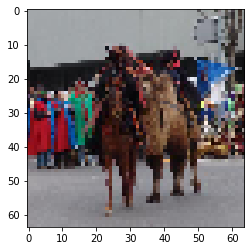

HOUSE


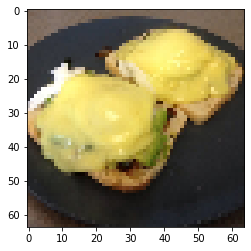

HOUSE


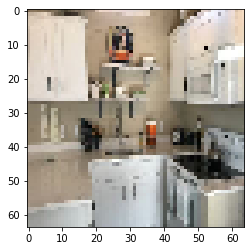

HOUSE


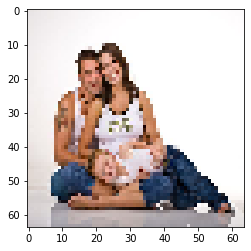

HOUSE


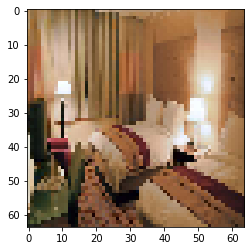

NOT HOUSE


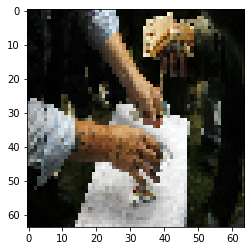

HOUSE


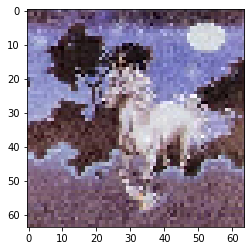

HOUSE


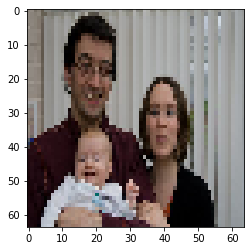

NOT HOUSE


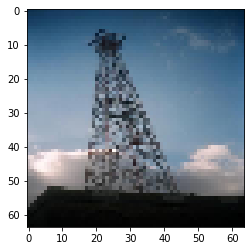

HOUSE


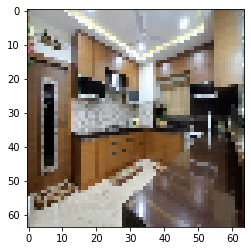

HOUSE


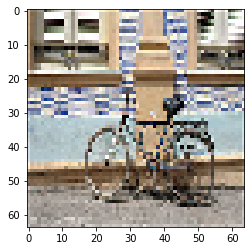

HOUSE


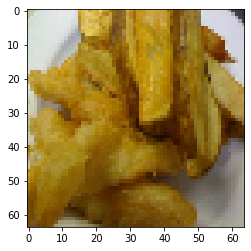

HOUSE


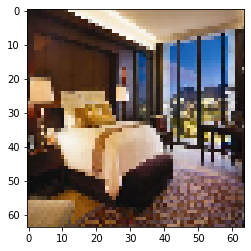

HOUSE


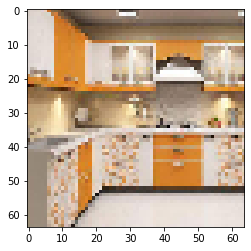

HOUSE


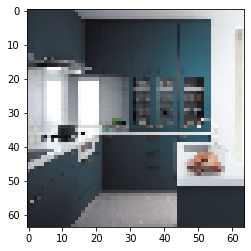

NOT HOUSE


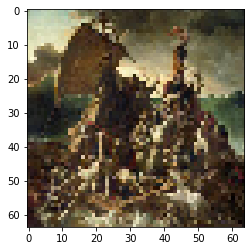

HOUSE


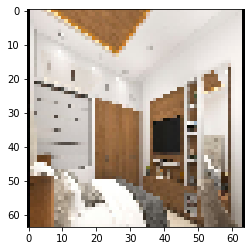

HOUSE


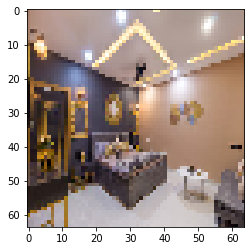

NOT HOUSE


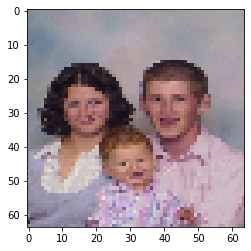

HOUSE


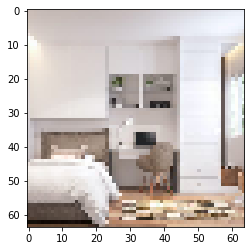

NOT HOUSE


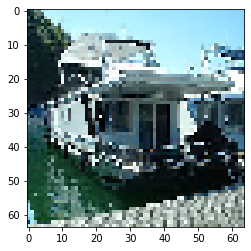

NOT HOUSE


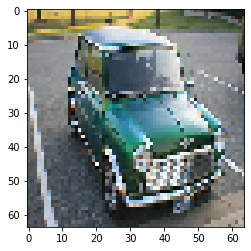

HOUSE


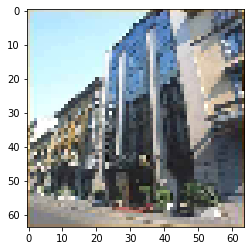

HOUSE


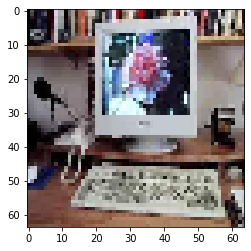

HOUSE


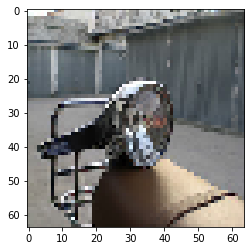

HOUSE


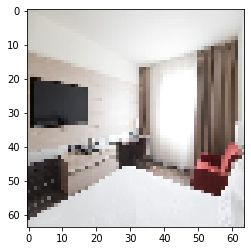

HOUSE


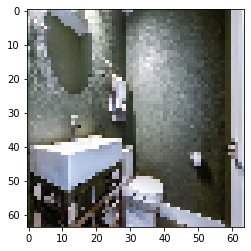

NOT HOUSE


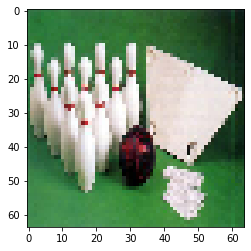

HOUSE


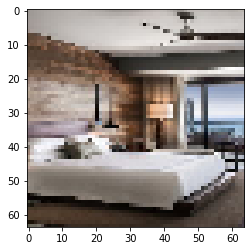

HOUSE


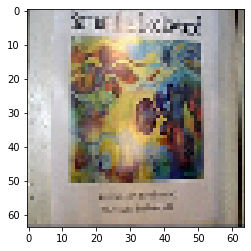

HOUSE


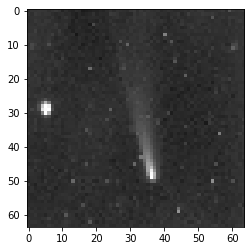

HOUSE


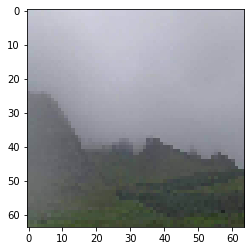

NOT HOUSE


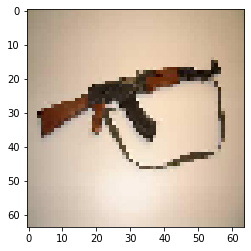

HOUSE


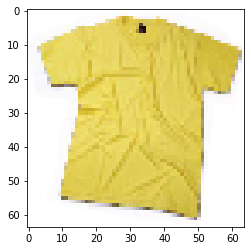

HOUSE


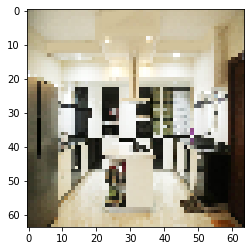

HOUSE


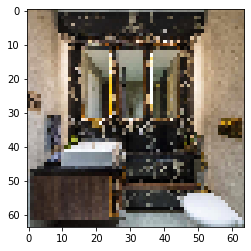

HOUSE


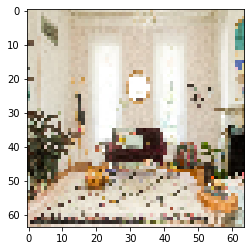

HOUSE


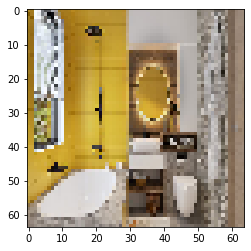

HOUSE


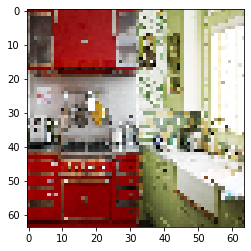

HOUSE


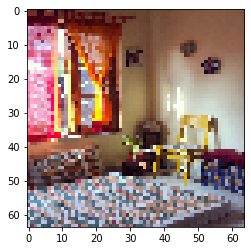

HOUSE


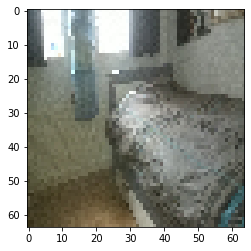

HOUSE


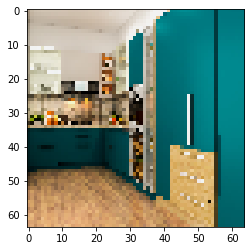

HOUSE


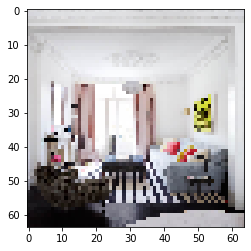

HOUSE


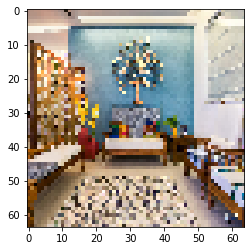

HOUSE


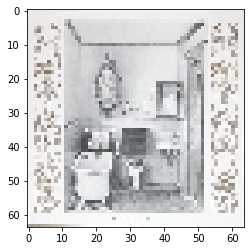

HOUSE


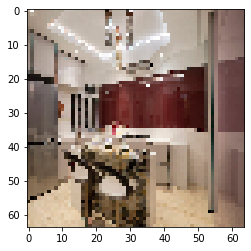

HOUSE


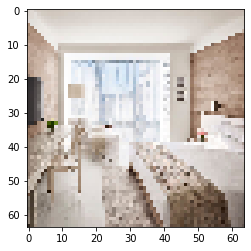

HOUSE


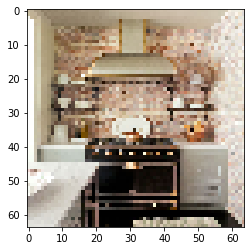

HOUSE


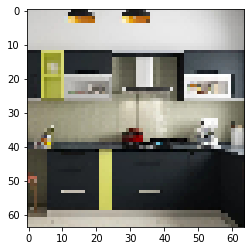

HOUSE


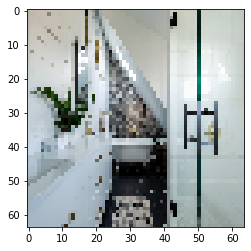

HOUSE


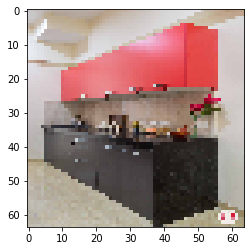

HOUSE


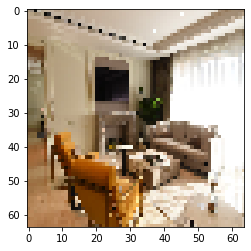

HOUSE


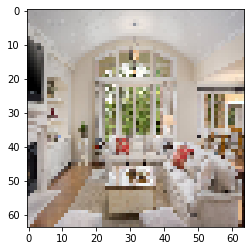

HOUSE


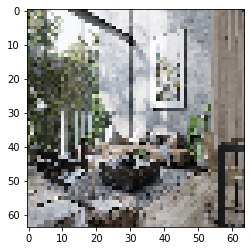

HOUSE


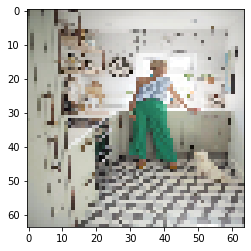

HOUSE


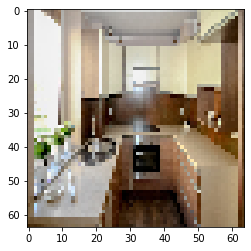

HOUSE


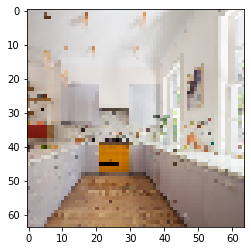

HOUSE


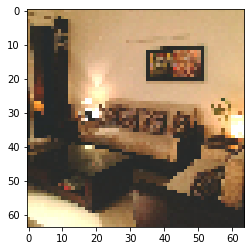

HOUSE


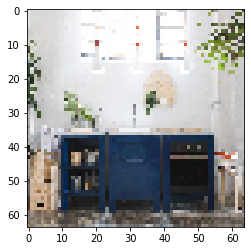

HOUSE


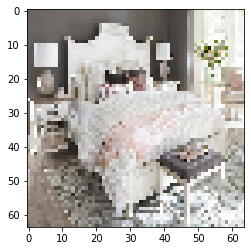

HOUSE


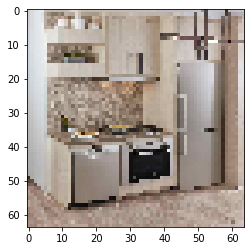

HOUSE


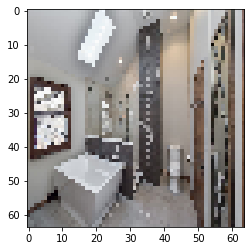

HOUSE


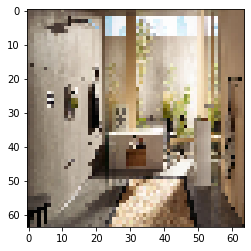

HOUSE


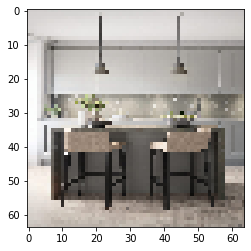

HOUSE


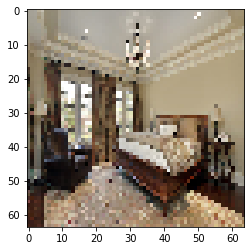

HOUSE


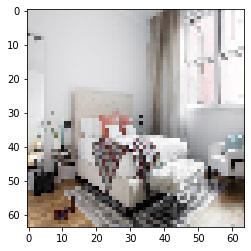

HOUSE


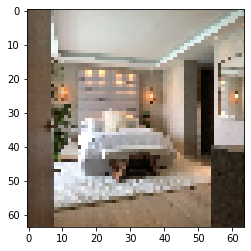

HOUSE


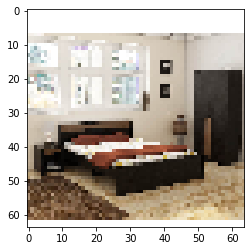

HOUSE


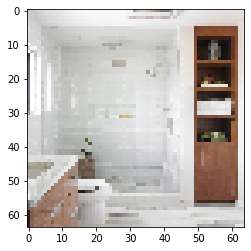

HOUSE


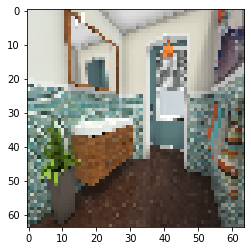

HOUSE


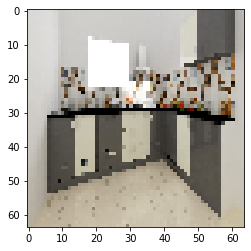

HOUSE


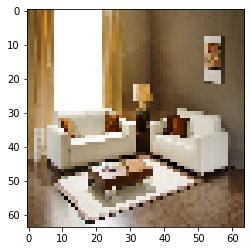

HOUSE


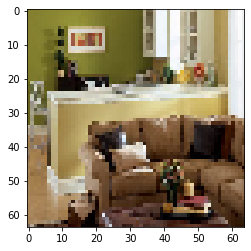

HOUSE


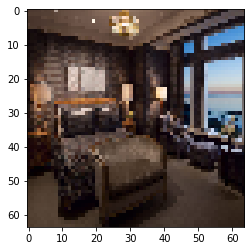

HOUSE


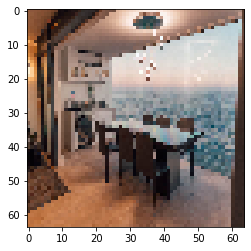

HOUSE


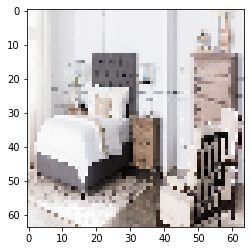

NOT HOUSE


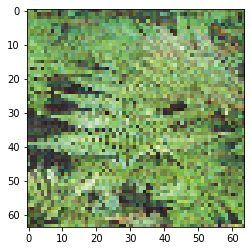

HOUSE


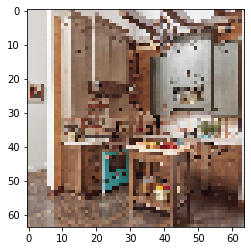

NOT HOUSE


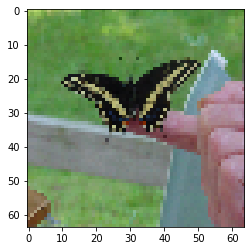

HOUSE


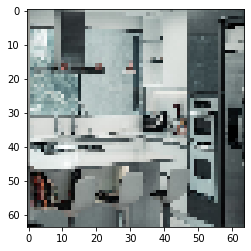

HOUSE


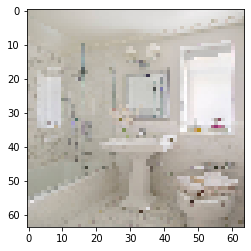

NOT HOUSE


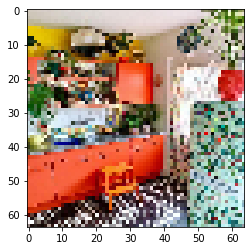

NOT HOUSE


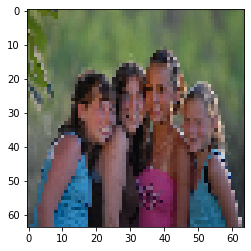

HOUSE


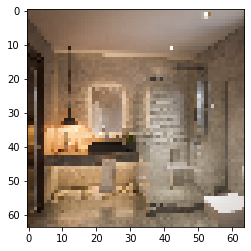

HOUSE


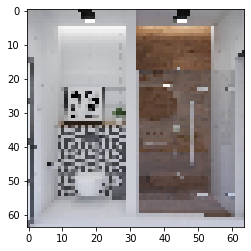

HOUSE


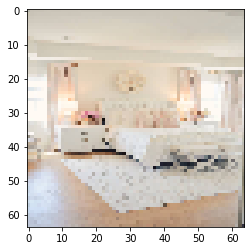

NOT HOUSE


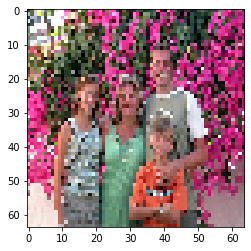

HOUSE


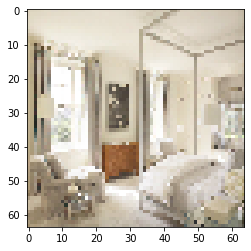

HOUSE


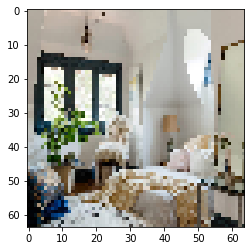

HOUSE


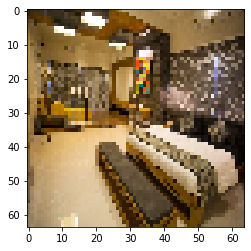

HOUSE


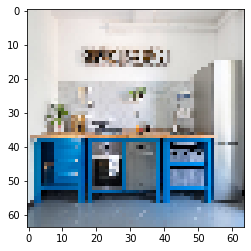

HOUSE


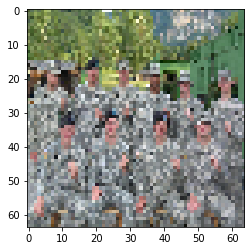

HOUSE


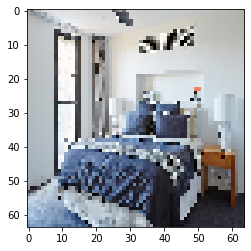

HOUSE


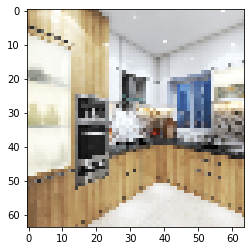

HOUSE


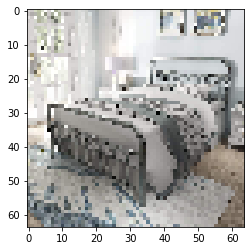

HOUSE


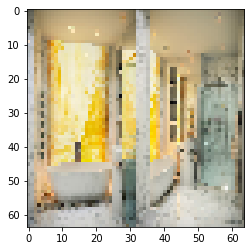

NOT HOUSE


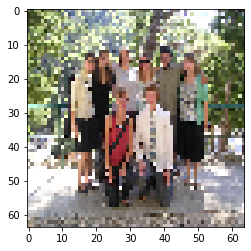

HOUSE


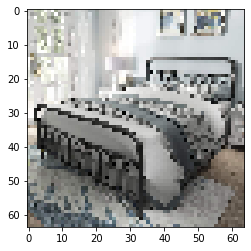

HOUSE


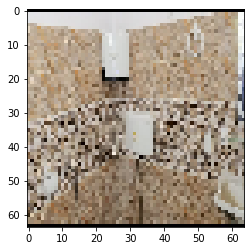

HOUSE


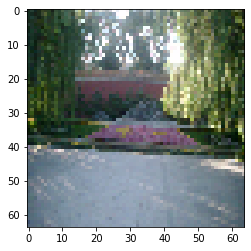

NOT HOUSE


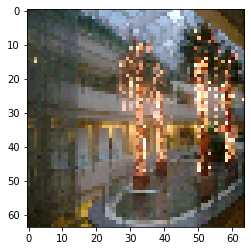

NOT HOUSE


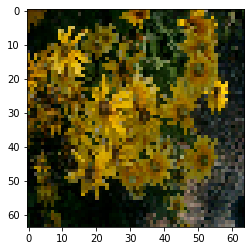

HOUSE


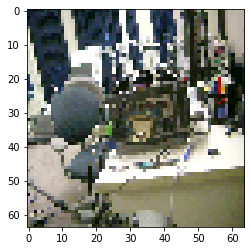

NOT HOUSE


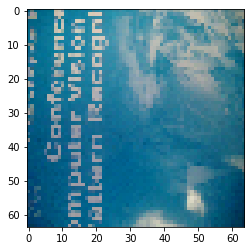

HOUSE


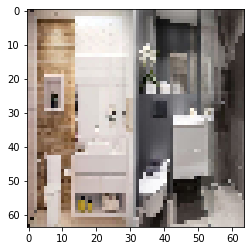

HOUSE


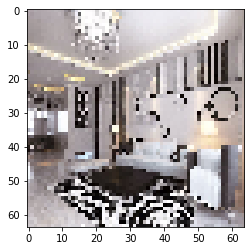

HOUSE


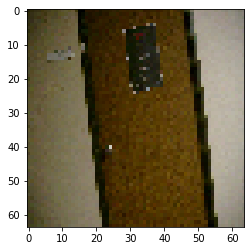

HOUSE


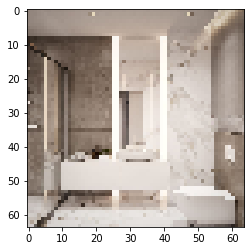

HOUSE


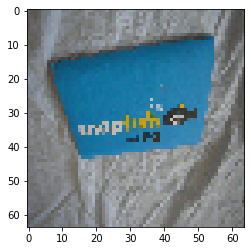

NOT HOUSE


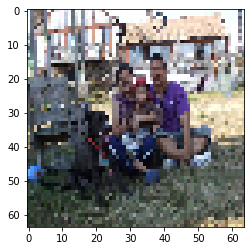

NOT HOUSE


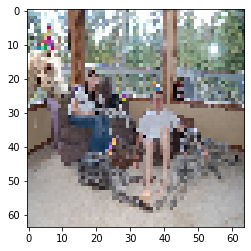

HOUSE


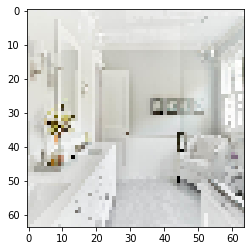

HOUSE


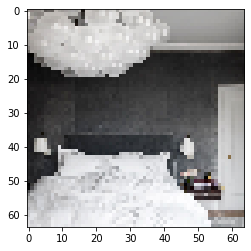

HOUSE


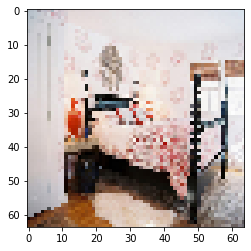

HOUSE


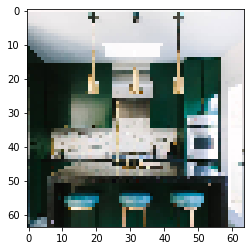

HOUSE


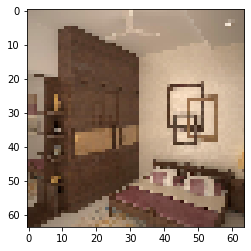

NOT HOUSE


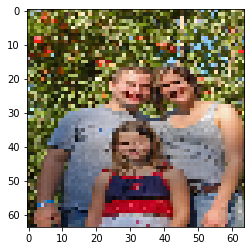

HOUSE


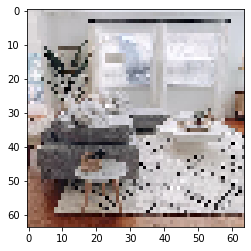

NOT HOUSE


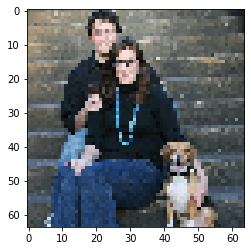

HOUSE


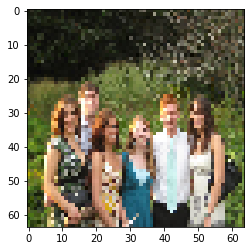

NOT HOUSE


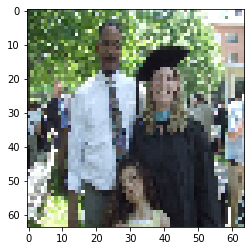

NOT HOUSE


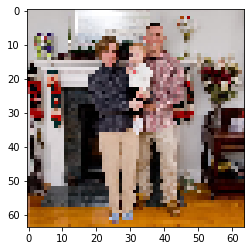

NOT HOUSE


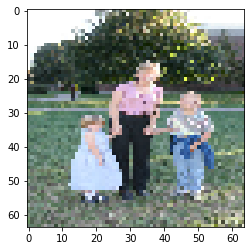

NOT HOUSE


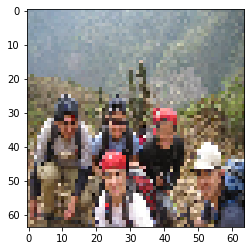

HOUSE


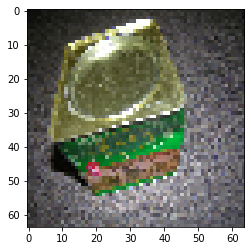

HOUSE


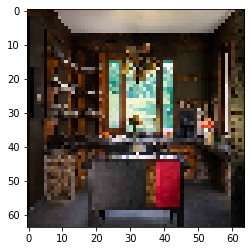

HOUSE


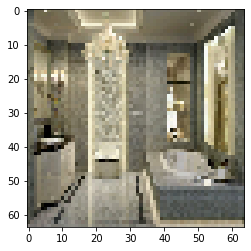

NOT HOUSE


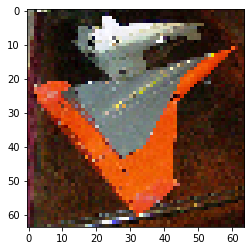

NOT HOUSE


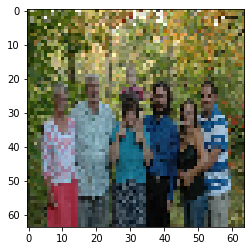

HOUSE


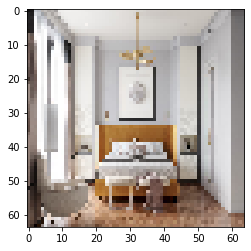

HOUSE


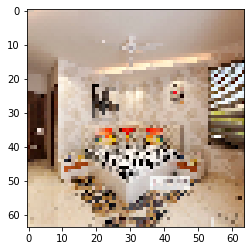

NOT HOUSE


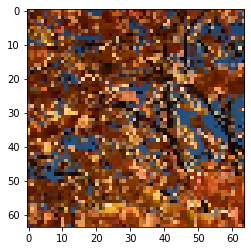

HOUSE


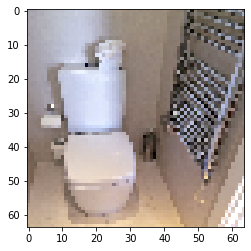

HOUSE


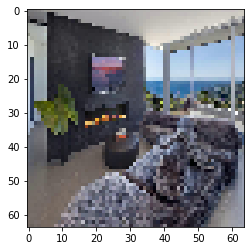

NOT HOUSE


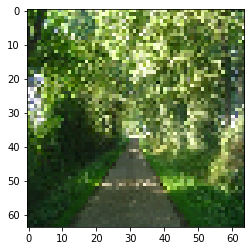

HOUSE


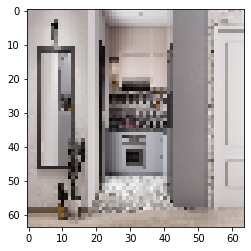

NOT HOUSE


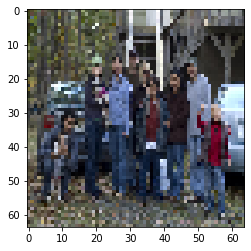

HOUSE


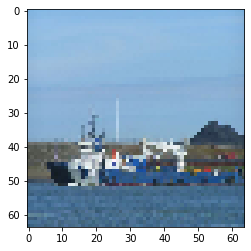

HOUSE


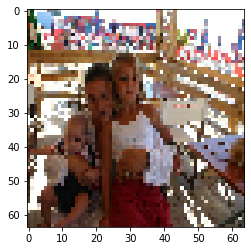

HOUSE


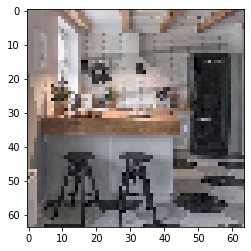

NOT HOUSE


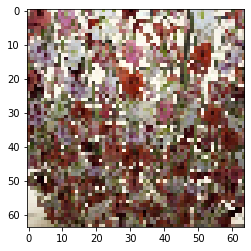

NOT HOUSE


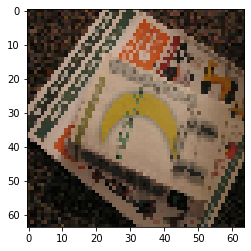

NOT HOUSE


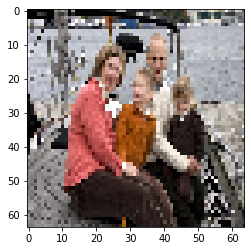

HOUSE


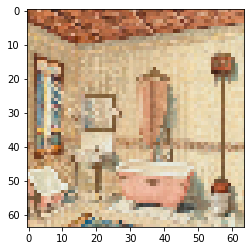

HOUSE


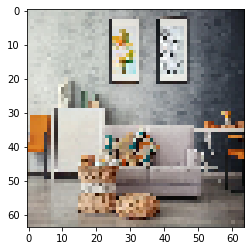

NOT HOUSE


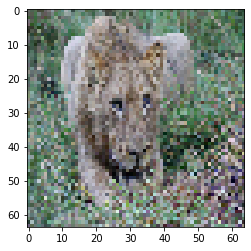

NOT HOUSE


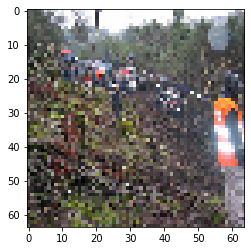

NOT HOUSE


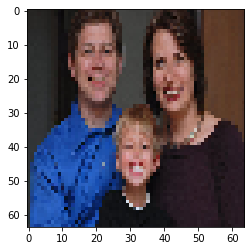

HOUSE


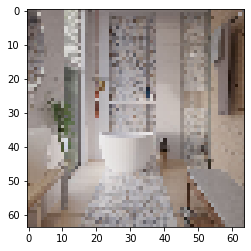

HOUSE


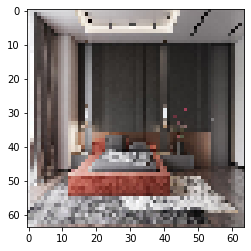

HOUSE


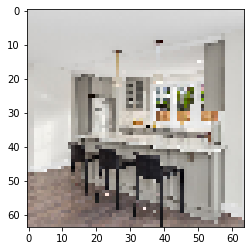

HOUSE


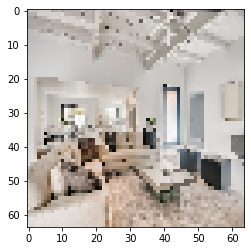

NOT HOUSE


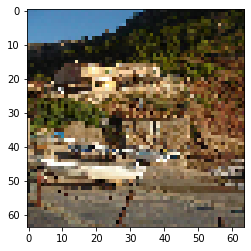

HOUSE


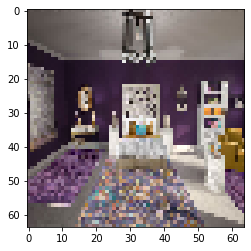

HOUSE


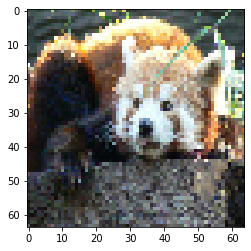

NOT HOUSE


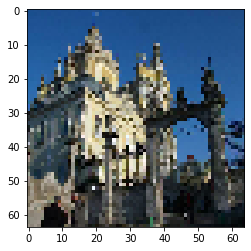

NOT HOUSE


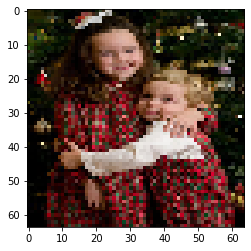

HOUSE


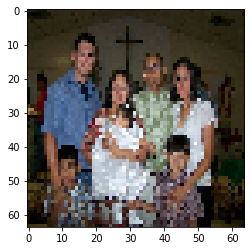

NOT HOUSE


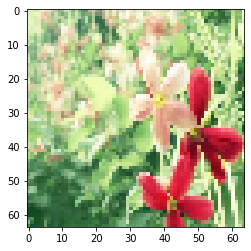

HOUSE


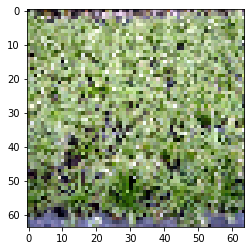

HOUSE


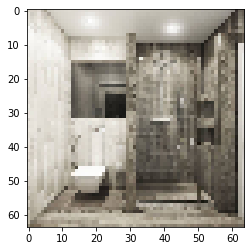

HOUSE


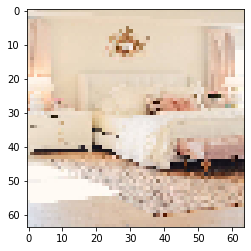

NOT HOUSE


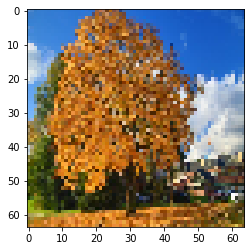

HOUSE


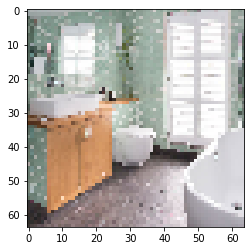

NOT HOUSE


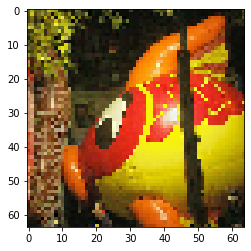

HOUSE


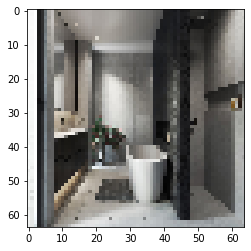

NOT HOUSE


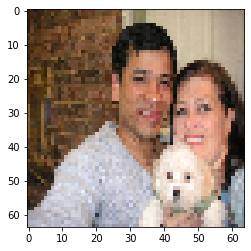

HOUSE


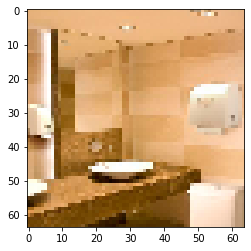

NOT HOUSE


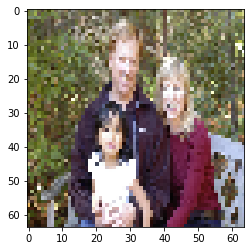

HOUSE


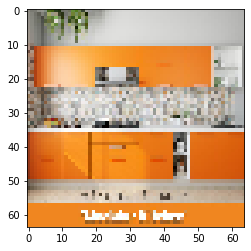

HOUSE


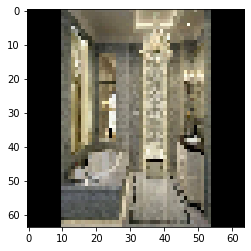

HOUSE


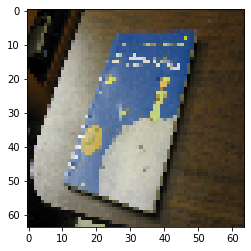

NOT HOUSE


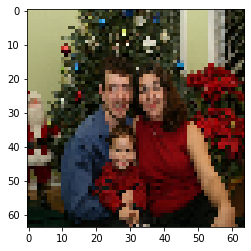

NOT HOUSE


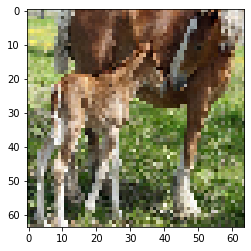

HOUSE


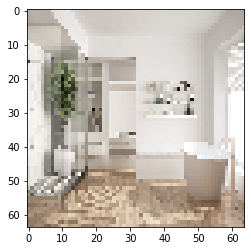

HOUSE


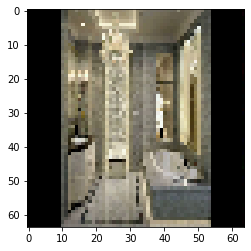

HOUSE


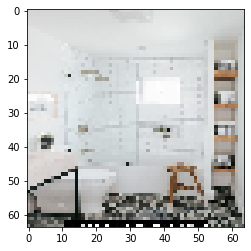

NOT HOUSE


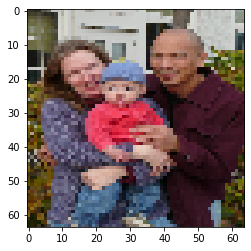

HOUSE


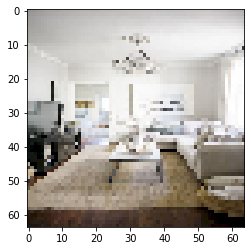

HOUSE


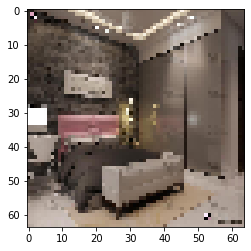

NOT HOUSE


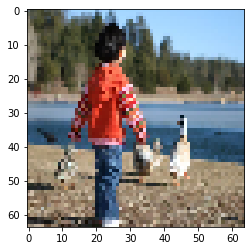

HOUSE


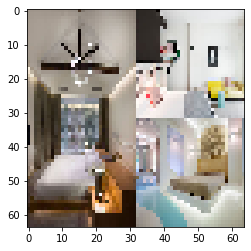

HOUSE


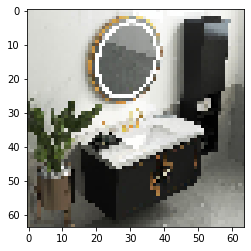

HOUSE


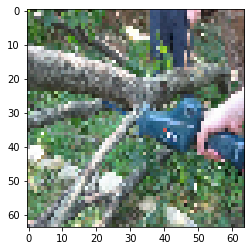

NOT HOUSE


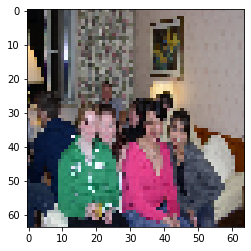

HOUSE


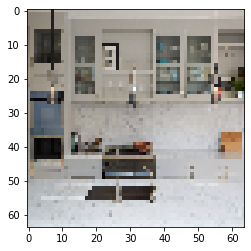

HOUSE


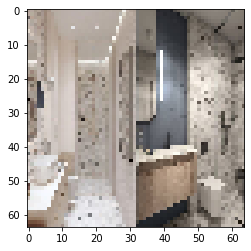

NOT HOUSE


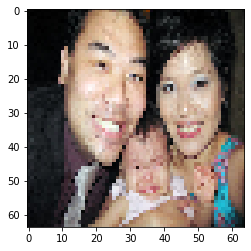

NOT HOUSE


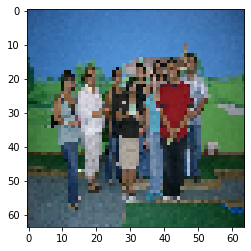

HOUSE


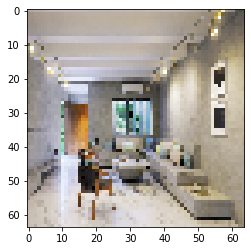

NOT HOUSE


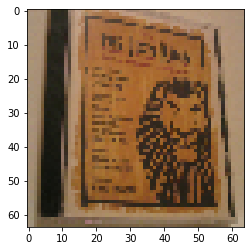

NOT HOUSE


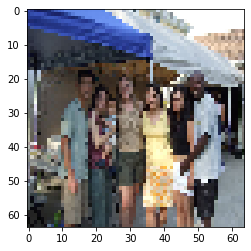

HOUSE


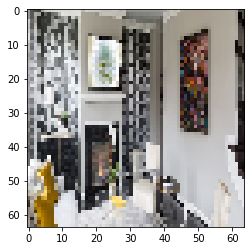

NOT HOUSE


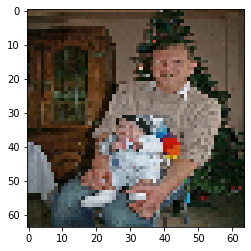

NOT HOUSE


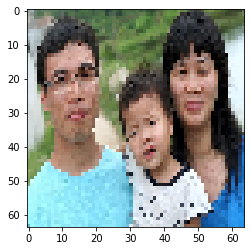

HOUSE


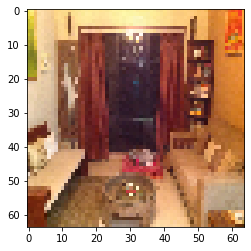

NOT HOUSE


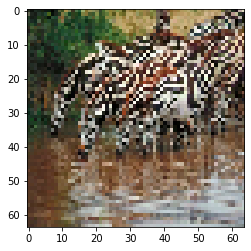

HOUSE


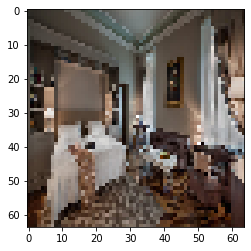

HOUSE


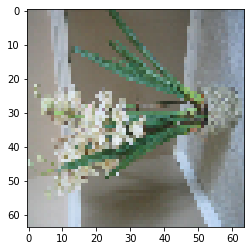

NOT HOUSE


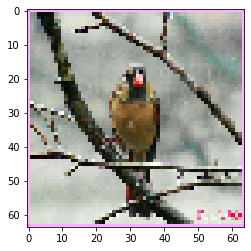

HOUSE


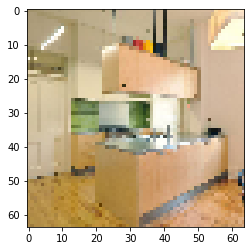

NOT HOUSE


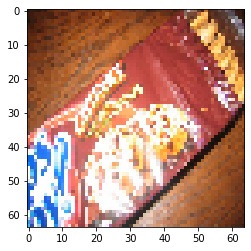

NOT HOUSE


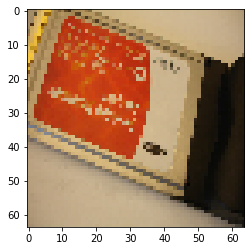

HOUSE


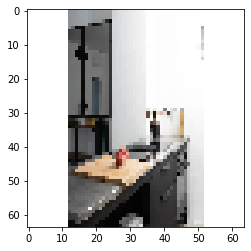

NOT HOUSE


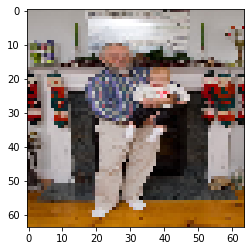

HOUSE


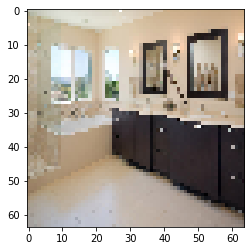

NOT HOUSE


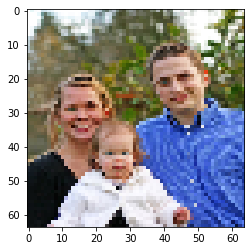

NOT HOUSE


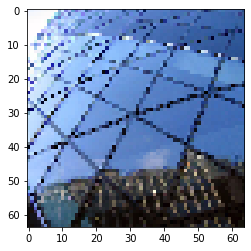

NOT HOUSE


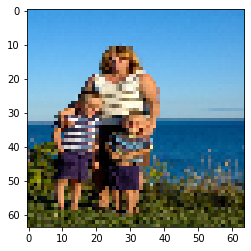

NOT HOUSE


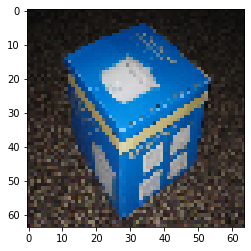

NOT HOUSE


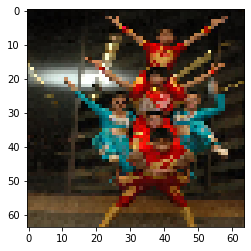

NOT HOUSE


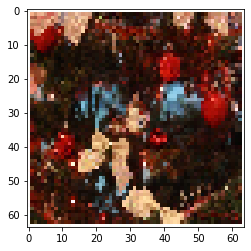

HOUSE


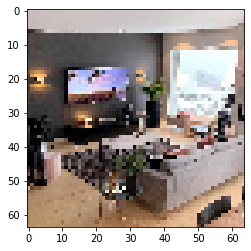

NOT HOUSE


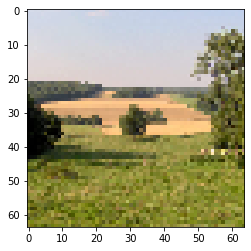

HOUSE


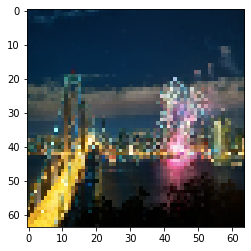

NOT HOUSE


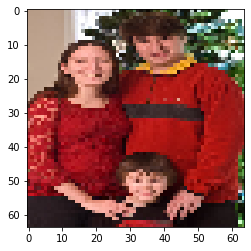

HOUSE


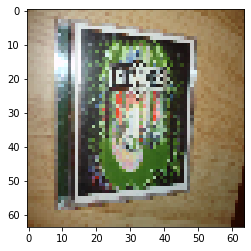

NOT HOUSE


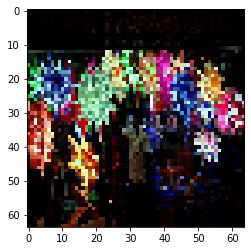

HOUSE


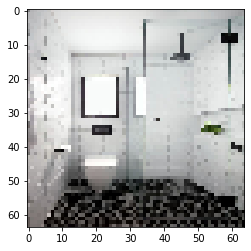

HOUSE


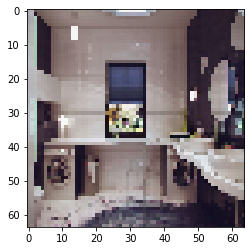

HOUSE


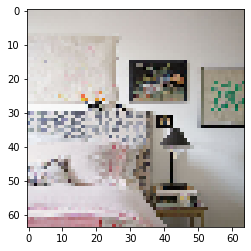

HOUSE


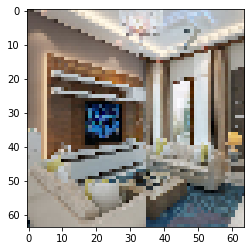

HOUSE


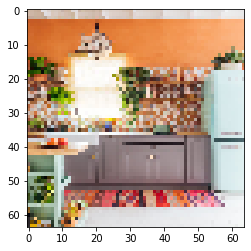

NOT HOUSE


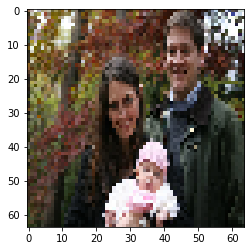

HOUSE


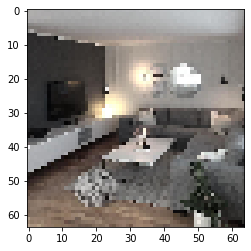

HOUSE


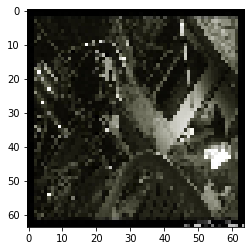

NOT HOUSE


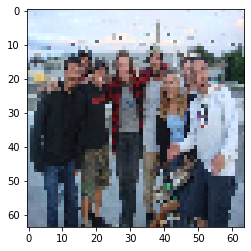

NOT HOUSE


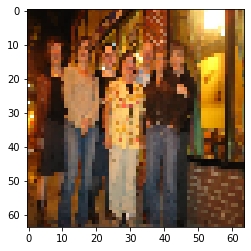

HOUSE


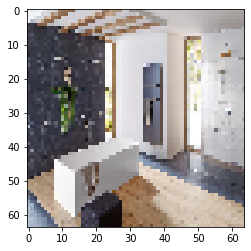

HOUSE


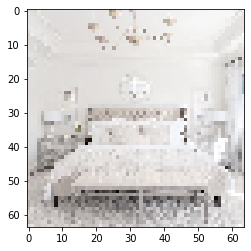

HOUSE


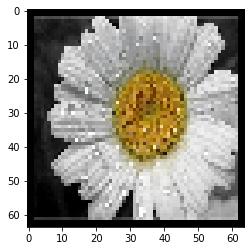

NOT HOUSE


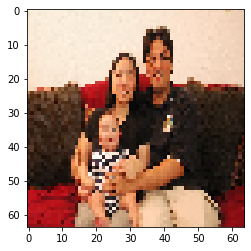

HOUSE


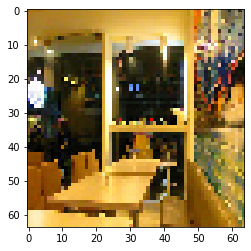

NOT HOUSE


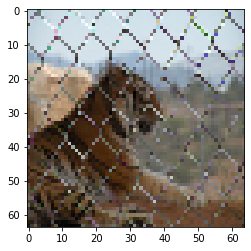

NOT HOUSE


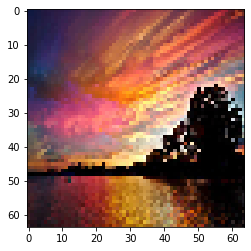

HOUSE


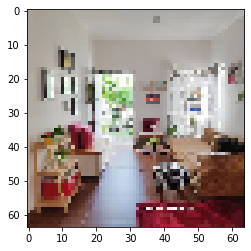

HOUSE


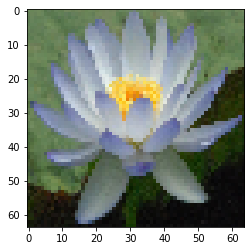

NOT HOUSE


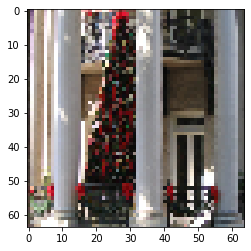

HOUSE


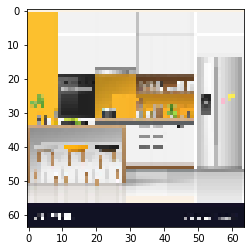

HOUSE


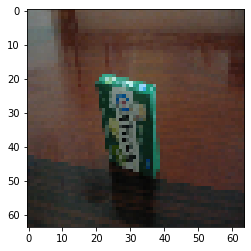

NOT HOUSE


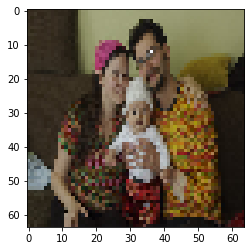

NOT HOUSE


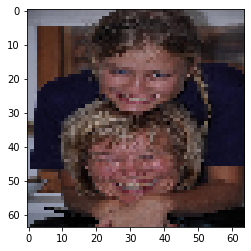

HOUSE


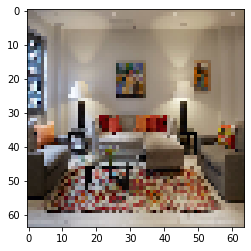

NOT HOUSE


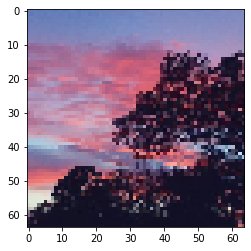

NOT HOUSE


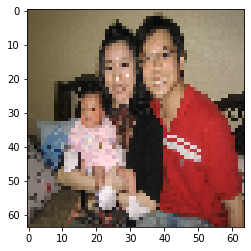

HOUSE


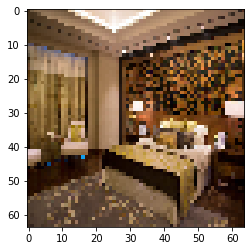

NOT HOUSE


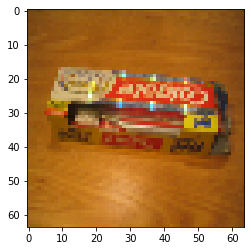

NOT HOUSE


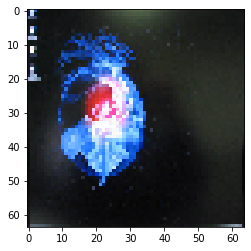

NOT HOUSE


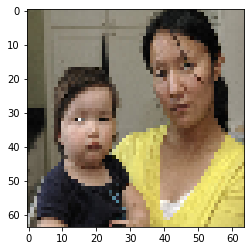

HOUSE


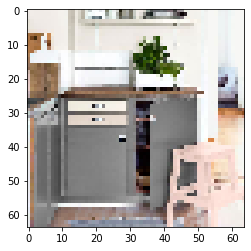

HOUSE


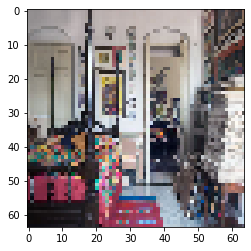

HOUSE


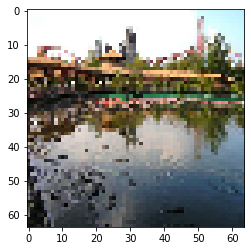

NOT HOUSE


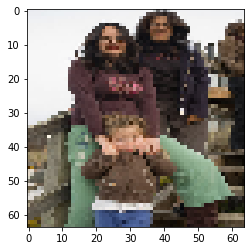

NOT HOUSE


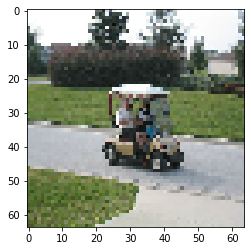

HOUSE


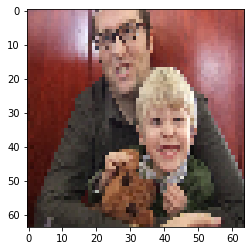

HOUSE


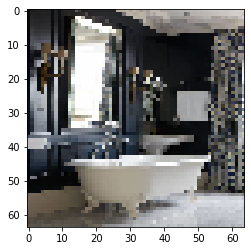

NOT HOUSE


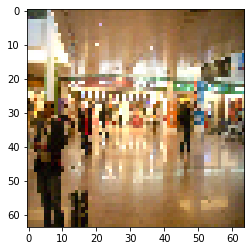

HOUSE


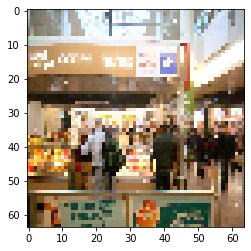

HOUSE


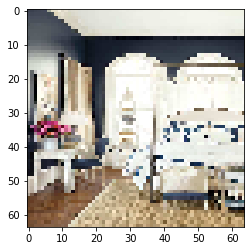

NOT HOUSE


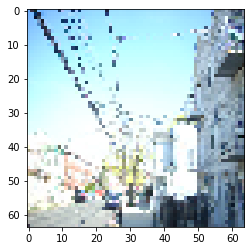

NOT HOUSE


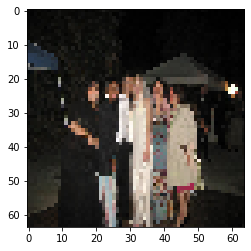

HOUSE


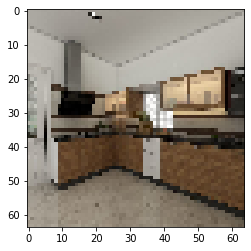

HOUSE


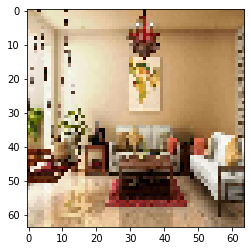

HOUSE


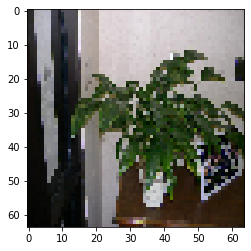

HOUSE


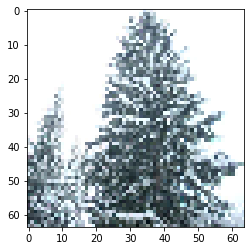

HOUSE


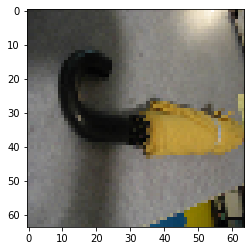

NOT HOUSE


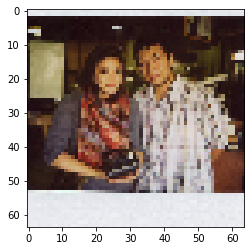

HOUSE


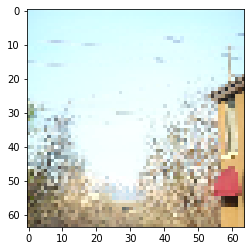

HOUSE


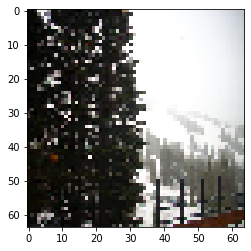

HOUSE


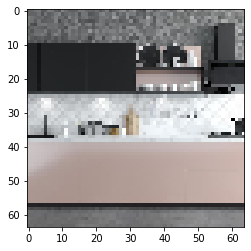

HOUSE


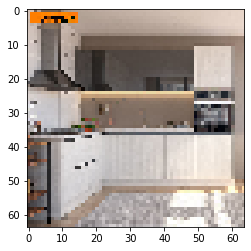

HOUSE


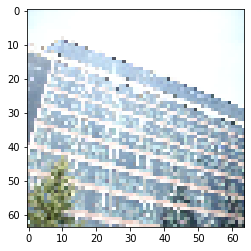

NOT HOUSE


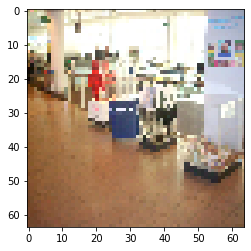

HOUSE


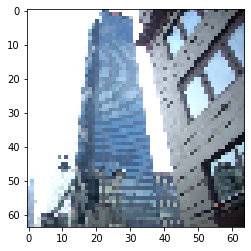

HOUSE


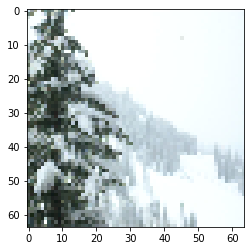

HOUSE


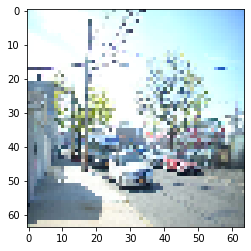

HOUSE


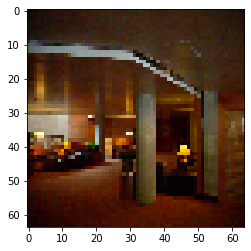

HOUSE


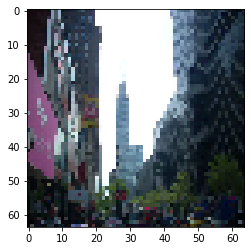

NOT HOUSE


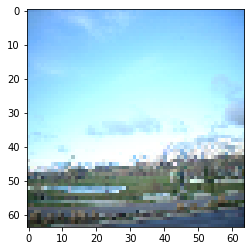

HOUSE


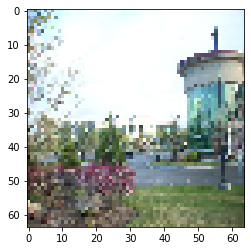

NOT HOUSE


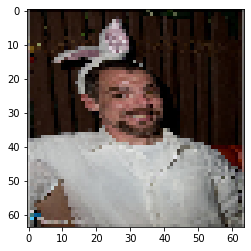

NOT HOUSE


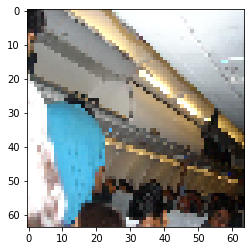

HOUSE


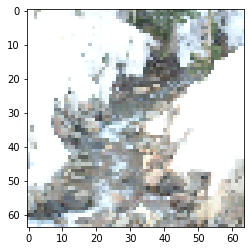

HOUSE


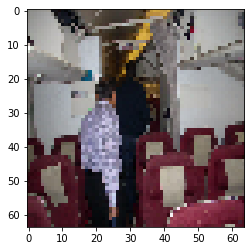

NOT HOUSE


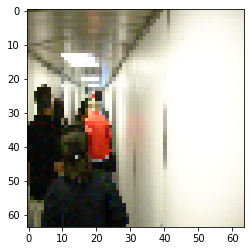

NOT HOUSE


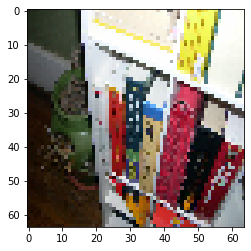

HOUSE


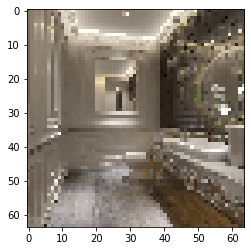

HOUSE


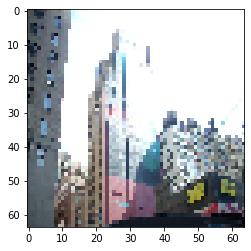

HOUSE


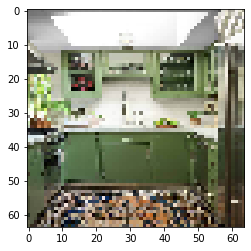

NOT HOUSE


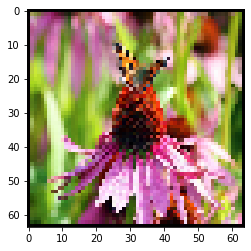

HOUSE


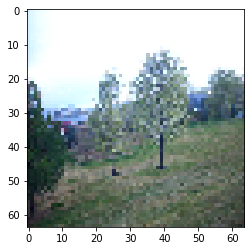

NOT HOUSE


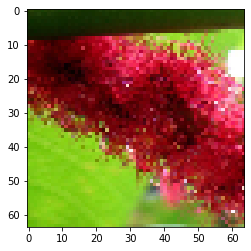

HOUSE


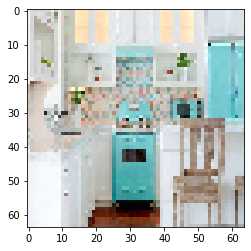

HOUSE


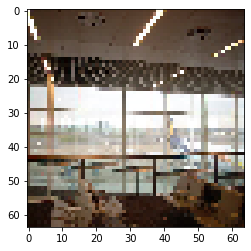

HOUSE


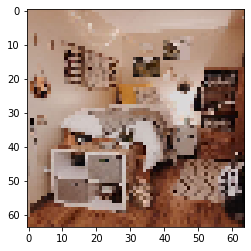

HOUSE


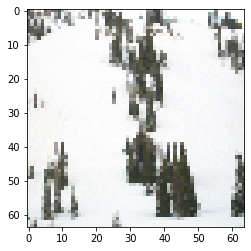

NOT HOUSE


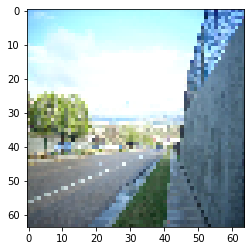

HOUSE


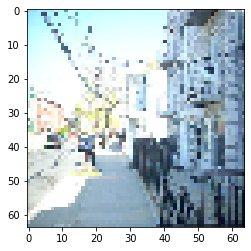

HOUSE


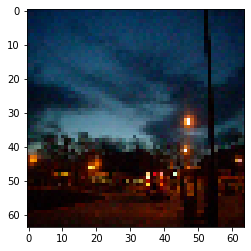

HOUSE


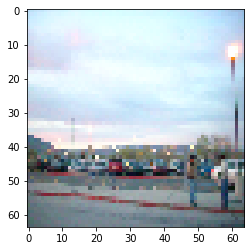

HOUSE


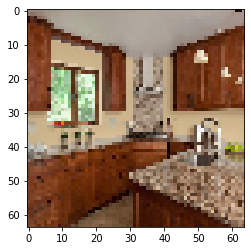

NOT HOUSE


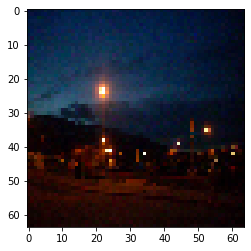

HOUSE


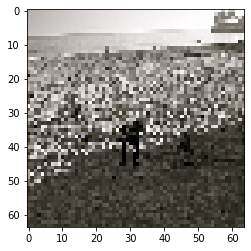

NOT HOUSE


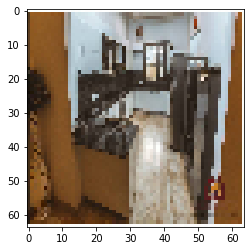

HOUSE


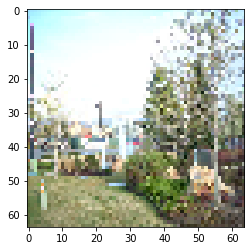

HOUSE


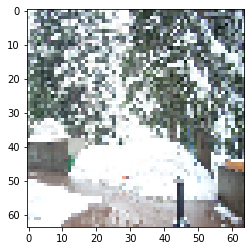

NOT HOUSE


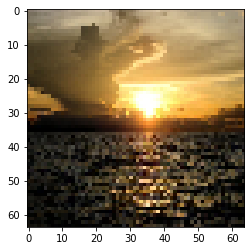

HOUSE


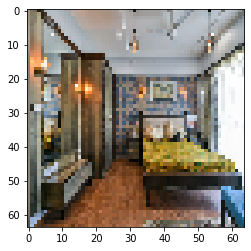

HOUSE


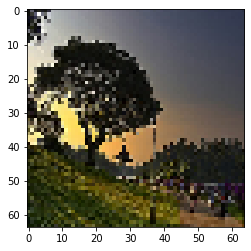

NOT HOUSE


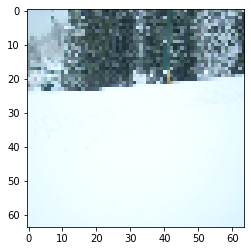

NOT HOUSE


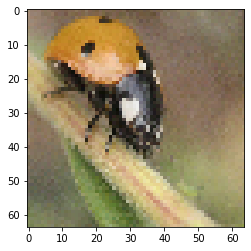

HOUSE


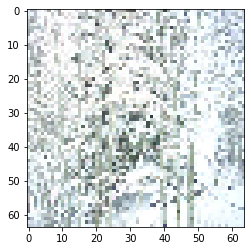

NOT HOUSE


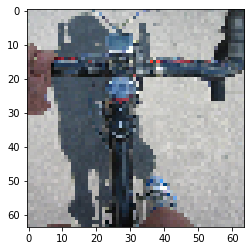

NOT HOUSE


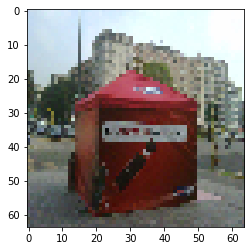

HOUSE


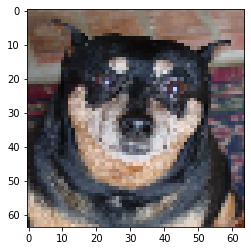

NOT HOUSE


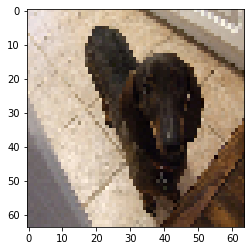

NOT HOUSE


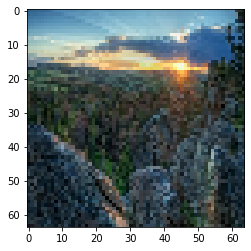

HOUSE


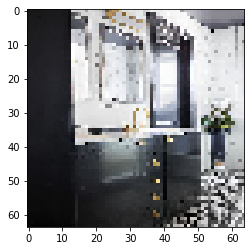

NOT HOUSE


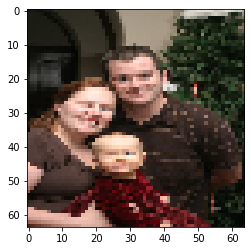

HOUSE


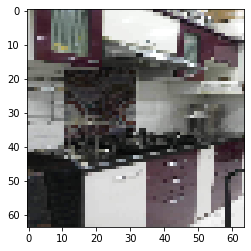

NOT HOUSE


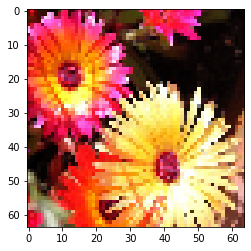

HOUSE


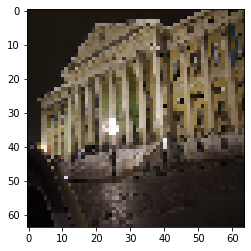

NOT HOUSE


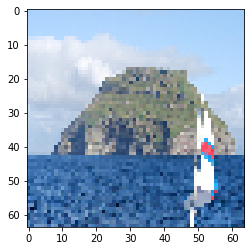

NOT HOUSE


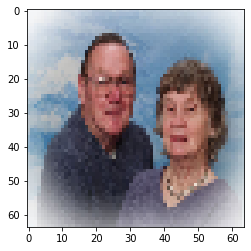

HOUSE


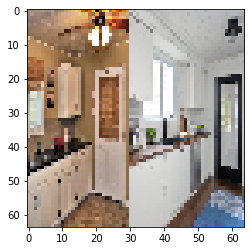

NOT HOUSE


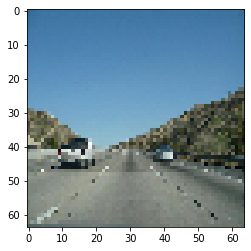

HOUSE


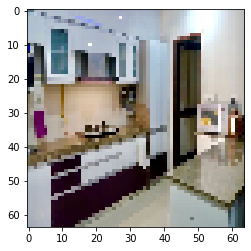

HOUSE


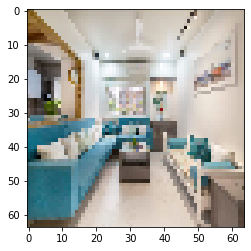

HOUSE


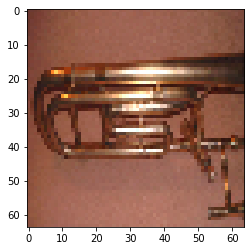

HOUSE


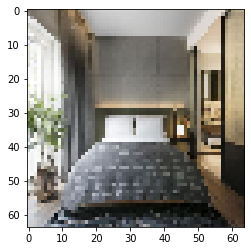

NOT HOUSE


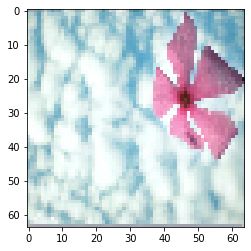

HOUSE


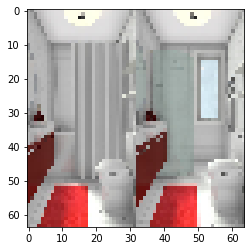

NOT HOUSE


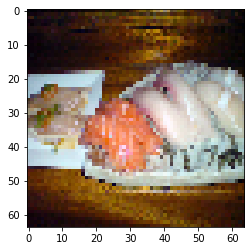

HOUSE


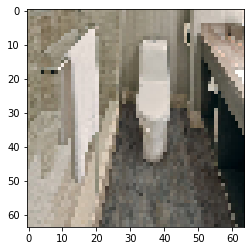

HOUSE


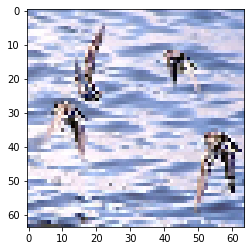

HOUSE


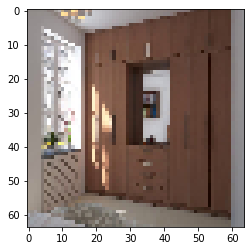

HOUSE


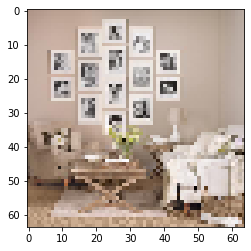

HOUSE


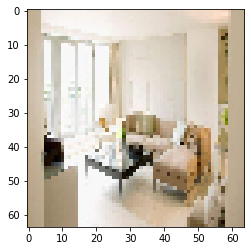

NOT HOUSE


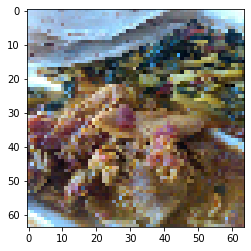

HOUSE


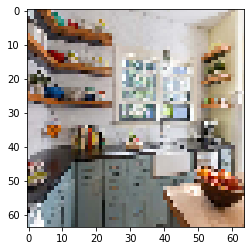

HOUSE


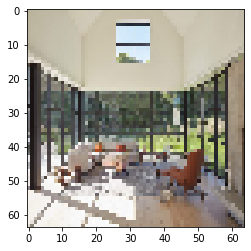

HOUSE


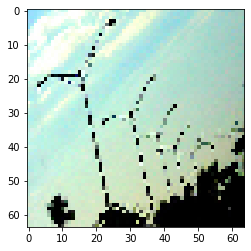

HOUSE


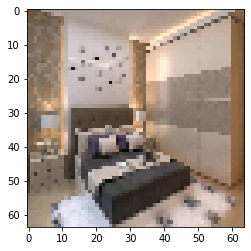

HOUSE


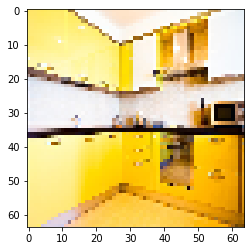

NOT HOUSE


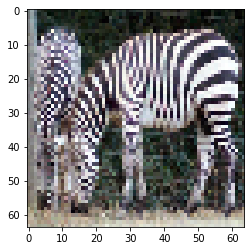

HOUSE


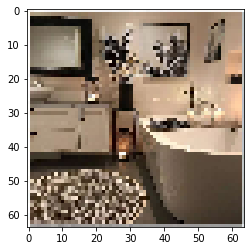

HOUSE


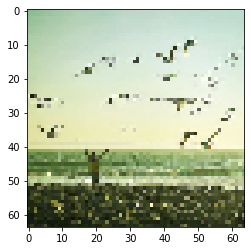

HOUSE


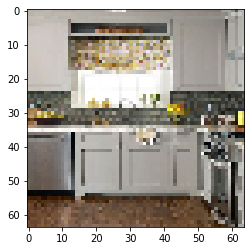

HOUSE


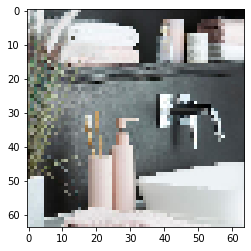

HOUSE


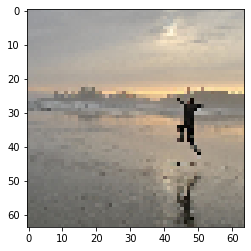

HOUSE


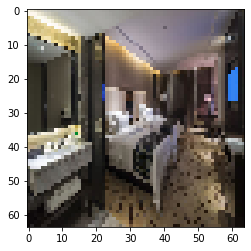

HOUSE


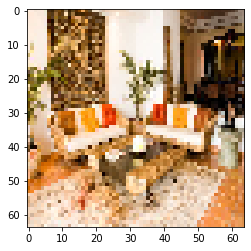

NOT HOUSE


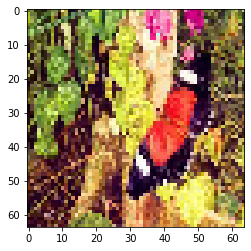

HOUSE


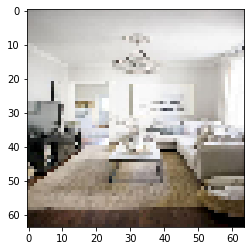

NOT HOUSE


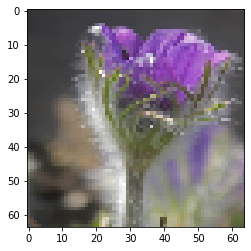

NOT HOUSE


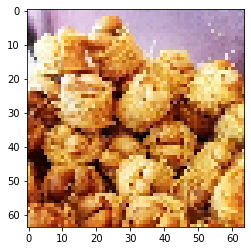

HOUSE


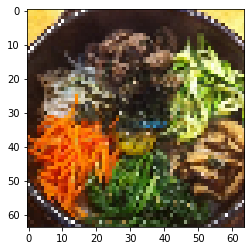

HOUSE


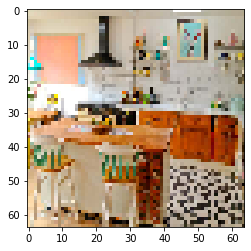

HOUSE


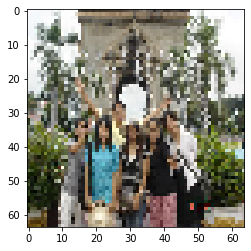

HOUSE


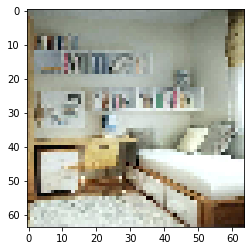

HOUSE


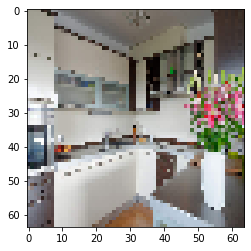

HOUSE


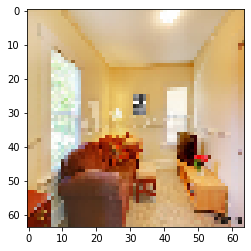

NOT HOUSE


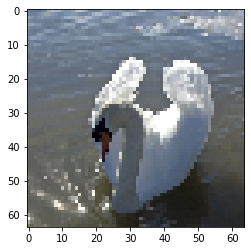

NOT HOUSE


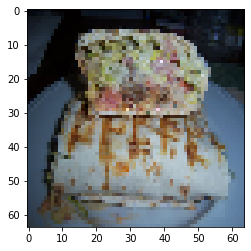

HOUSE


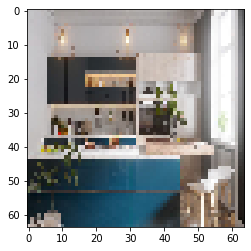

NOT HOUSE


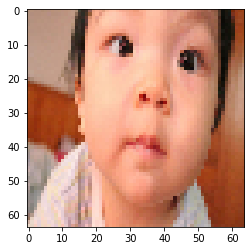

NOT HOUSE


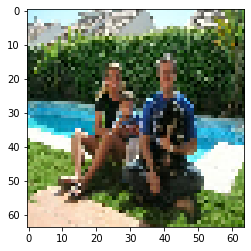

NOT HOUSE


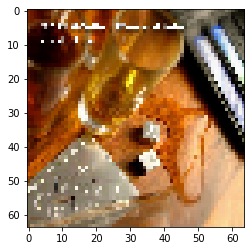

HOUSE


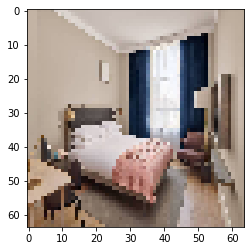

NOT HOUSE


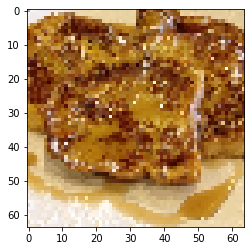

HOUSE


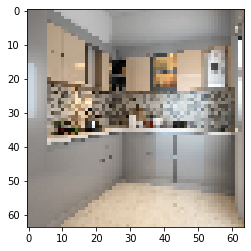

HOUSE


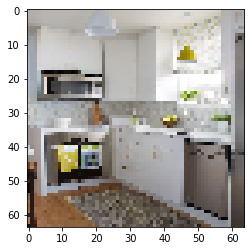

NOT HOUSE


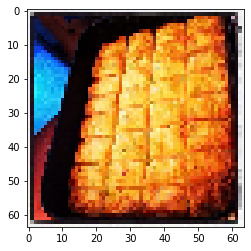

HOUSE


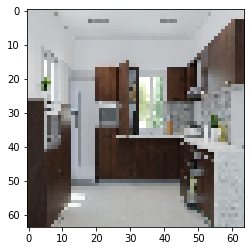

NOT HOUSE


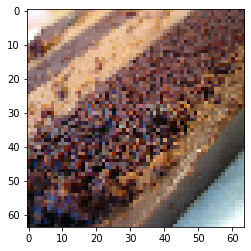

In [68]:
from matplotlib import pyplot
for i,j in zip(files,result_test):
    new_image=image.load_img(i,target_size=(64,64))
    print(j)
    #print(testing_image(i))
    pyplot.imshow(new_image)
    pyplot.show()

In [95]:
from matplotlib import pyplot
fig, ax = plt.subplots(nrows = 51 , ncols =10, figsize = (400,150))
for i,j,k in zip(files,result_test,ax.flatten()):
    new_image=image.load_img(i,target_size=(64,64))
    k.set_title(j)
    k.imshow(new_image)
pyplot.show()
plt.tight_layout() 

<Figure size 432x288 with 0 Axes>